# 📖 Glossary

This section defines key terms and concepts used in this analysis.

- **Steam**: A popular digital distribution platform for PC games.
- **Positive Ratings**: The number of users who gave a game a positive review.
- **Negative Ratings**: The number of users who gave a game a negative review.
- **Positive Review Percentage**: The percentage of positive reviews calculated as:  
  \[
  \text{Positive Review Percentage} = \left( \frac{\text{Positive Ratings}}{\text{Positive Ratings} + \text{Negative Ratings}} \right) \times 100
  \]
- **Rating**: The classification label based on positive review percentage:
  - **Very Positive**: ≥ 85%
  - **Positive**: 70% - 84.99%
  - **Negative**: 40% - 69.99%
  - **Very Negative**: < 40%
- **Feature Selection**: The process of identifying the most important features for classification.
- **Correlation**: A statistical measure of how two variables move together.


# SETUP

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns 
import plotly
import plotly.graph_objects as go
import plotly.express as px
from sklearn.metrics import ConfusionMatrixDisplay

In [2]:
df = pd.read_csv("steam.csv")
df_original = df.copy()

In [3]:
steam = df.copy()

# Intro

Steam is a virtual game store and a virtual game library. The dataset shows different information about games that are in steam, such as their price, rating, genres and how many people own the games.

## 1- the dataset has 27075 rows with 17 columns

In [4]:
steam.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27075 entries, 0 to 27074
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   appid             27075 non-null  int64  
 1   name              27075 non-null  object 
 2   release_date      27075 non-null  object 
 3   english           27075 non-null  int64  
 4   developer         27074 non-null  object 
 5   publisher         27061 non-null  object 
 6   platforms         27075 non-null  object 
 7   required_age      27075 non-null  int64  
 8   categories        27075 non-null  object 
 9   genres            27075 non-null  object 
 10  steamspy_tags     27075 non-null  object 
 11  achievements      27075 non-null  int64  
 12  positive_ratings  27075 non-null  int64  
 13  negative_ratings  27075 non-null  int64  
 14  average_playtime  27075 non-null  int64  
 15  median_playtime   27075 non-null  int64  
 16  owners            27075 non-null  object

## 2- Features we'll be looking at in the dataset:


1.   release_date - when was the game released
2.   english - is the game available in english or not
3.   categories - the category of the game, such as singleplayer or multiplayer
4.   genres - what kind of game is it
5.   achievements - number of achievements available for each game
6.   rating - we'll be calculating what type of rating the game has (very positive, positive, negative, very negative)
7.   median_playtime - median playtime of the game across users
8.   owners - number of owners of the game
9.   price - the price of the game
10.  required_age - the age required to play the game
11.  average_playtime - the average playtime of the game

**Categorial features**

1.   english
2.   categories - this will be split into two categories (singleplayer and multiplayer)
3.   generes - this will be split into there generes (indie, action and adventure)
4.   rating - this is calculated from: positive_ratings, negative_ratings
5.   owners - the way this dataset is set, the number of owners is divided into ranges


**Numeric features**


1.  release_date
2.  achievements
3.  median_playtime
4.  price
5.  required_age
6.  average_playtime

## 3- general look at the dataset before cleaning

Statistical overview

In [5]:
steam.describe(include = 'all')

,appid,name,release_date,english,developer,publisher,platforms,required_age,categories,genres,steamspy_tags,achievements,positive_ratings,negative_ratings,average_playtime,median_playtime,owners,price
count,2.707500e+04,27075,27075,27075.000000,27074,27061,27075,27075.000000,27075,27075,27075,27075.000000,2.707500e+04,27075.000000,27075.000000,27075.00000,27075,27075.000000
unique,NaN,27033,2619,NaN,17112,14353,7,NaN,3333,1552,6423,NaN,NaN,NaN,NaN,NaN,13,NaN
top,NaN,Dark Matter,2018-07-13,NaN,Choice of Games,Big Fish Games,windows,NaN,Single-player,Action;Indie,Action;Indie;Casual,NaN,NaN,NaN,NaN,NaN,0-20000,NaN
freq,NaN,3,64,NaN,94,212,18398,NaN,6110,1852,845,NaN,NaN,NaN,NaN,NaN,18596,NaN
mean,5.962035e+05,NaN,NaN,0.981127,NaN,NaN,NaN,0.354903,NaN,NaN,NaN,45.248864,1.000559e+03,211.027147,149.804949,146.05603,NaN,6.078193
std,2.508942e+05,NaN,NaN,0.136081,NaN,NaN,NaN,2.406044,NaN,NaN,NaN,352.670281,1.898872e+04,4284.938531,1827.038141,2353.88008,NaN,7.874922
min,1.000000e+01,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000,0.000000e+00,0.000000,0.000000,0.00000,NaN,0.000000
25%,4.012300e+05,NaN,NaN,1.000000,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000,6.000000e+00,2.000000,0.000000,0.00000,NaN,1.690000
50%,5.990700e+05,NaN,NaN,1.000000,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,7.000000,2.400000e+01,9.000000,0.000000,0.00000,NaN,3.990000
75%,7.987600e+05,NaN,NaN,1.000000,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,23.000000,1.260000e+02,42.000000,0.000000,0.00000,NaN,7.190000


We can see that there's no empty features

In [6]:
steam.isnull().sum()

appid                0
name                 0
release_date         0
english              0
developer            1
publisher           14
platforms            0
required_age         0
categories           0
genres               0
steamspy_tags        0
achievements         0
positive_ratings     0
negative_ratings     0
average_playtime     0
median_playtime      0
owners               0
price                0
dtype: int64

# Initial Data Analysis

### Initial look at statistical anaylsis

In [7]:
steam.describe()

,appid,english,required_age,achievements,positive_ratings,negative_ratings,average_playtime,median_playtime,price
count,2.707500e+04,27075.000000,27075.000000,27075.000000,2.707500e+04,27075.000000,27075.000000,27075.00000,27075.000000
mean,5.962035e+05,0.981127,0.354903,45.248864,1.000559e+03,211.027147,149.804949,146.05603,6.078193
std,2.508942e+05,0.136081,2.406044,352.670281,1.898872e+04,4284.938531,1827.038141,2353.88008,7.874922
min,1.000000e+01,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.00000,0.000000
25%,4.012300e+05,1.000000,0.000000,0.000000,6.000000e+00,2.000000,0.000000,0.00000,1.690000
50%,5.990700e+05,1.000000,0.000000,7.000000,2.400000e+01,9.000000,0.000000,0.00000,3.990000
75%,7.987600e+05,1.000000,0.000000,23.000000,1.260000e+02,42.000000,0.000000,0.00000,7.190000
max,1.069460e+06,1.000000,18.000000,9821.000000,2.644404e+06,487076.000000,190625.000000,190625.00000,421.990000


## Reasoning for keeping some features out

We can see that all appid's are unique so there shouldn't be duplicate rows of the same game, we can remove appid column safely.

Also I'll be droping the name column since a game name has no meaning.

In [8]:
steam['appid'].value_counts()

appid
1069460    1
10         1
20         1
1057710    1
1058000    1
          ..
70         1
80         1
130        1
220        1
240        1
Name: count, Length: 27075, dtype: int64

The non Windows game are only 4 games, so I'll be removing them from the dataframe and droping the platforms column

In [9]:
steam['platforms'].value_counts()

platforms
windows              18398
windows;mac;linux     4623
windows;mac           3439
windows;linux          610
mac                      3
mac;linux                1
linux                    1
Name: count, dtype: int64

for original dataset, split platfroms to onehot encoded columns

In [10]:
platform_mask = steam['platforms'].isin(['mac', 'mac;linux', 'linux'])
steam = steam[~platform_mask]

In [11]:
linux_mask = df_original['platforms'].str.contains('linux', case=False)
df_original['linux'] = linux_mask.astype(int)

mac_mask = df_original['platforms'].str.contains('mac', case=False)
df_original['mac'] = mac_mask.astype(int)

windows_mask = df_original['platforms'].str.contains('windows', case=False)
df_original['windows'] = windows_mask.astype(int)

In [12]:
df_original.drop(columns=['platforms'], inplace=True)

drop features from original dataset that arent continuous or onhot encoded (for decision tree)

In [13]:
df_original.drop(columns=['developer', 'publisher', 'appid', 'name', 'steamspy_tags'], inplace=True)

there's more than 14k developers and publishers which is more than half the dataframe so I'll count these two features out

In [14]:
steam['developer'].value_counts()

developer
Choice of Games               94
KOEI TECMO GAMES CO., LTD.    72
Ripknot Systems               62
Laush Dmitriy Sergeevich      51
Nikita "Ghost_RUS"            50
                              ..
Project ICKX                   1
Funkitron                      1
Cross Eaglet                   1
Naked Sky Entertainment        1
Marco Ayala Games              1
Name: count, Length: 17109, dtype: int64

In [15]:
steam['publisher'].value_counts()

publisher
Big Fish Games            212
Strategy First            136
Ubisoft                   111
THQ Nordic                 98
Square Enix                97
                         ... 
Unstoppable Pug Studio      1
Z.A.Games                   1
Atreyu Games Pty. Ltd.      1
Sole                        1
Roxiano Creations           1
Name: count, Length: 14349, dtype: int64

a look at top 10 developers and top 10 publishers before removing these features

In [16]:
top_10_devs = steam['developer'].value_counts().sort_values(ascending=False).head(10)

fig = go.Figure()
fig.add_trace(go.Bar(x=top_10_devs.index, y=top_10_devs.values))
fig.update_layout(
    height=800, width=600, title_text='TOP 10 STEAM DEVELOPERS', yaxis_title='count', title_x = 0.5
)

fig.show()

In [17]:
top_10_publishers = steam['publisher'].value_counts().sort_values(ascending=False).head(10)

fig = go.Figure()
fig.add_trace(go.Bar(x=top_10_publishers.index, y=top_10_publishers.values))
fig.update_layout(
    height=800, width=600, title_text='TOP 10 STEAM PUBLISHERS', yaxis_title='count', title_x = 0.5
)

fig.show()

genres and steamspy_tags are representing similar information, so I'll be looking at genres when spliting the game genres into different columns

In [18]:
steam[['genres', 'steamspy_tags']]

,genres,steamspy_tags
0,Action,Action;FPS;Multiplayer
1,Action,Action;FPS;Multiplayer
2,Action,FPS;World War II;Multiplayer
3,Action,Action;FPS;Multiplayer
4,Action,FPS;Action;Sci-fi
...,...,...
27070,Adventure;Casual;Indie,Adventure;Indie;Casual
27071,Action;Adventure;Indie,Action;Indie;Adventure
27072,Action;Casual;Indie,Action;Indie;Casual
27073,Adventure;Casual;Indie,Indie;Casual;Adventure


removing the features mentioned above

In [19]:
steam.drop(columns=['appid','name','platforms', 'publisher', 'developer', 'steamspy_tags'], inplace=True)

split categories and genres to onehot encoded in original dataset

splitting string into arrays where ; is the seperator

In [20]:
df_original_copy = df_original.copy()

In [21]:
measurer = np.vectorize(len)
categories_arrays = df_original['categories'].copy().str.split(";")
categories_arrays.apply(lambda x: len(x)).max()

np.int64(18)

In [22]:
measurer = np.vectorize(len)
genres_arrays = df_original['genres'].copy().str.split(";")
genres_arrays.apply(lambda x: len(x)).max()

np.int64(16)

In [23]:
df_original_copy['categories'] = categories_arrays
df_original_copy['genres'] = genres_arrays

splitting the array into onehot encoded columns

In [24]:
df1 = pd.DataFrame([list(x) for x in df_original_copy['categories']], index=df_original_copy.index).add_prefix('cat')
df2 = pd.get_dummies(df1)

In [25]:
df_original_copy = df_original_copy.join(df2)

In [26]:
df1 = pd.DataFrame([list(x) for x in df_original_copy['genres']], index=df_original_copy.index).add_prefix('genre')
df2 = pd.get_dummies(df1)

In [27]:
df_original_copy = df_original_copy.join(df2)

In [28]:
df_original_copy.drop(columns=['genres','categories'], inplace=True)

In [29]:
df_original_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27075 entries, 0 to 27074
Columns: 486 entries, release_date to genre15_Game Development
dtypes: bool(473), float64(1), int64(10), object(2)
memory usage: 14.9+ MB


## Fixing some categorial features

### Spliting genres into 3 columns: indie, action, adventure

In [30]:
indie_mask = steam.genres.str.contains('Indie', case=False)
action_mask = steam.genres.str.contains('Action', case=False)
adventure_mask = steam.genres.str.contains('Adventure', case=False)
print(len(steam[indie_mask]))
print(len(steam[action_mask]))
print(len(steam[adventure_mask]))

19418
11901
10030


In [31]:
steam['indie'] = indie_mask.astype(int)
steam['action'] = action_mask.astype(int)
steam['adventure'] = adventure_mask.astype(int)

In [32]:
zero_one=[0, 1]
steam['indie'] = pd.Categorical(steam['indie'], categories=zero_one, ordered=True)
steam['action'] = pd.Categorical(steam['action'], categories=zero_one, ordered=True)
steam['adventure'] = pd.Categorical(steam['adventure'], categories=zero_one, ordered=True)

In [33]:
steam.drop(columns=['genres'], inplace=True)

### Splitting categories into singleplayer, mutliplayer

In [34]:
singleplayer_mask = steam.categories.str.contains('Single-player', case=False)
multiplayer_mask = steam.categories.str.contains('Multi-Player', case=False)
print(len(steam[singleplayer_mask]))
print(len(steam[multiplayer_mask]))

25673
5307


In [35]:
steam['singleplayer'] = singleplayer_mask.astype(int)
steam['multiplayer'] = multiplayer_mask.astype(int)

In [36]:
steam['singleplayer'] = pd.Categorical(steam['singleplayer'], categories=zero_one, ordered=True)
steam['multiplayer'] = pd.Categorical(steam['multiplayer'], categories=zero_one, ordered=True)

In [37]:
steam.drop(columns=['categories'], inplace=True)

### Creating rating feature

In [38]:
steam['positive_ratio'] = steam['positive_ratings']/(steam['positive_ratings']+steam['negative_ratings'])
steam['negative_ratio'] = steam['negative_ratings']/(steam['positive_ratings']+steam['negative_ratings'])

In [39]:
df_original['positive_ratio'] = df_original['positive_ratings']/(df_original['positive_ratings']+df_original['negative_ratings'])
df_original['negative_ratio'] = df_original['negative_ratings']/(df_original['positive_ratings']+df_original['negative_ratings'])

In [40]:
steam.describe()

,english,required_age,achievements,positive_ratings,negative_ratings,average_playtime,median_playtime,price,positive_ratio,negative_ratio
count,27070.000000,27070.000000,27070.000000,2.707000e+04,27070.000000,27070.000000,27070.000000,27070.000000,27070.000000,27070.000000
mean,0.981123,0.353713,45.254710,1.000735e+03,211.061470,149.832619,146.083007,6.078508,0.714463,0.285537
std,0.136093,2.401991,352.702395,1.899047e+04,4285.333476,1827.205738,2354.096630,7.875229,0.233600,0.233600
min,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.000000,0.000000,0.000000,6.000000e+00,2.000000,0.000000,0.000000,1.690000,0.583333,0.106137
50%,1.000000,0.000000,7.000000,2.400000e+01,9.000000,0.000000,0.000000,3.990000,0.760331,0.239669
75%,1.000000,0.000000,23.000000,1.260000e+02,42.000000,0.000000,0.000000,7.190000,0.893863,0.416667
max,1.000000,18.000000,9821.000000,2.644404e+06,487076.000000,190625.000000,190625.000000,421.990000,1.000000,1.000000


In [41]:
very_positive_mask = steam['positive_ratio'] >= 0.75
positive_mask = (0.75 > steam['positive_ratio']) & (steam['positive_ratio'] >= 0.5)
negative_mask = (0.5 > steam['positive_ratio']) & (steam['positive_ratio'] >= 0.25)
very_negative_mask = 0.25 > steam['positive_ratio']

print(len(steam.loc[very_positive_mask, 'positive_ratio']))
print(len(steam.loc[positive_mask, 'positive_ratio']))
print(len(steam.loc[negative_mask, 'positive_ratio']))
print(len(steam.loc[very_negative_mask, 'positive_ratio']))

14338
8496
3047
1189


In [42]:
steam['positive_ratio'] = steam['positive_ratio'].astype(str)

steam.loc[very_positive_mask, 'positive_ratio'] = 'very positive'
steam.loc[positive_mask, 'positive_ratio'] = 'positive'
steam.loc[negative_mask, 'positive_ratio'] = 'negative'
steam.loc[very_negative_mask, 'positive_ratio'] = 'very negative'

In [43]:
very_positive_mask = df_original['positive_ratio'] >= 0.75
positive_mask = (0.75 > df_original['positive_ratio']) & (df_original['positive_ratio'] >= 0.5)
negative_mask = (0.5 > df_original['positive_ratio']) & (df_original['positive_ratio'] >= 0.25)
very_negative_mask = 0.25 > df_original['positive_ratio']

In [44]:
df_original['positive_ratio'] = df_original['positive_ratio'].astype(str)

df_original.loc[very_positive_mask, 'positive_ratio'] = 'very positive'
df_original.loc[positive_mask, 'positive_ratio'] = 'positive'
df_original.loc[negative_mask, 'positive_ratio'] = 'negative'
df_original.loc[very_negative_mask, 'positive_ratio'] = 'very negative'

In [45]:
steam['rating'] = steam['positive_ratio']
steam.drop(columns=['positive_ratio', 'negative_ratio', 'positive_ratings', 'negative_ratings'], inplace=True)

In [46]:
df_original['rating'] = df_original['positive_ratio']
df_original.drop(columns=['positive_ratio', 'negative_ratio', 'positive_ratings', 'negative_ratings'], inplace=True)

In [47]:
rating=['very negative', 'negative', 'positive', 'very positive']
steam['rating'] = pd.Categorical(steam['rating'], categories=rating, ordered=True)

In [48]:
steam['rating'].value_counts()

rating
very positive    14338
positive          8496
negative          3047
very negative     1189
Name: count, dtype: int64

### Spliting release_date into month and day features

the reasoning is to see if releasing in a certain month, or day in the month affects the game popularity

In [49]:
steam['release_date'] = pd.to_datetime(steam['release_date'])
steam['day'] = steam['release_date'].dt.day
steam['month'] = steam['release_date'].dt.month
steam['year'] = steam['release_date'].dt.year

In [50]:
df_original['release_date'] = pd.to_datetime(df_original['release_date'])
df_original['day'] = df_original['release_date'].dt.day
df_original['month'] = df_original['release_date'].dt.month
df_original['year'] = df_original['release_date'].dt.year

In [51]:
month=range(1,13)
steam['month'] = pd.Categorical(steam['month'], categories=month, ordered=True)

day=range(1,32)
steam['day'] = pd.Categorical(steam['day'], categories=day, ordered=True)

In [52]:
steam.drop(columns=['release_date'], inplace=True)

In [53]:
df_original.drop(columns=['release_date'], inplace=True)

### Setting english feature as categorical

In [54]:
steam['english'] = pd.Categorical(steam['english'], categories=zero_one, ordered=True)

### Looking at owners feature

we can see 'outliers' but they represent most popular games

In [55]:
steam['owners'].value_counts()

owners
0-20000                18592
20000-50000             3059
50000-100000            1694
100000-200000           1386
200000-500000           1272
500000-1000000           513
1000000-2000000          288
2000000-5000000          193
5000000-10000000          46
10000000-20000000         21
20000000-50000000          3
50000000-100000000         2
100000000-200000000        1
Name: count, dtype: int64

In [56]:
owners=['0-20000', '20000-50000', '50000-100000', '100000-200000', '200000-500000', '500000-1000000', '1000000-2000000', '2000000-5000000', '5000000-10000000',
        '10000000-20000000', '20000000-50000000', '50000000-100000000', '100000000-200000000']
steam['owners'] = pd.Categorical(steam['owners'], categories=owners, ordered=True)

In [57]:
top_6_owned = steam[
            (steam['owners'] == '20000000-50000000') | 
            (steam['owners'] == '50000000-100000000') | 
            (steam['owners'] == '100000000-200000000')
          ].sort_values(by='owners')

top_6_owned

,english,required_age,achievements,average_playtime,median_playtime,owners,price,indie,action,adventure,singleplayer,multiplayer,rating,day,month,year
19,1,0,520,8495,623,20000000-50000000,0.00,0,1,0,0,1,very positive,10,10,2007
1634,1,16,187,5845,394,20000000-50000000,0.00,0,1,0,1,1,very positive,25,3,2013
3362,1,0,46,3248,413,20000000-50000000,0.00,1,1,1,1,1,very positive,7,7,2017
25,1,0,167,22494,6502,50000000-100000000,0.00,0,1,0,0,1,very positive,21,8,2012
12836,1,0,37,22938,12434,50000000-100000000,26.99,0,1,1,0,1,positive,21,12,2017
22,1,0,0,23944,801,100000000-200000000,0.00,0,1,0,0,1,very positive,9,7,2013


### Looking for outliers

In [58]:
import seaborn as sns
import matplotlib.pyplot as plt

def boxplot_per_feature(df, features):
    plt.figure(figsize=(12, 5))
    for feature in features:
        sns.boxplot(x=df[feature])
        plt.title(f"Boxplot for {feature}")
        plt.show()

In [59]:
def boxplots_sameFeature(df, categorical_features, numerical_feature):
    plt.figure(figsize=(12, 5))
    for category in categorical_features:
        sns.boxplot(x=df[category], y=df[numerical_feature])  # Remove `palette`
        plt.title(f"Boxplot of {numerical_feature} grouped by {category}")
        plt.xticks(rotation=45)
        plt.show()

In [60]:
def scatterplot_per_feature(df, features, y_feature):
  """
  draw a scatterplot for each feature in df against y_feature
  """
  plt.figure(figsize=[25, 25])
  index=1
  for feature in features:
    plt.subplot(5, 5, index)
    sns.scatterplot(data=df, x=feature, y=y_feature, palette="crest")
    index += 1

#### checking for outliers in numerical features

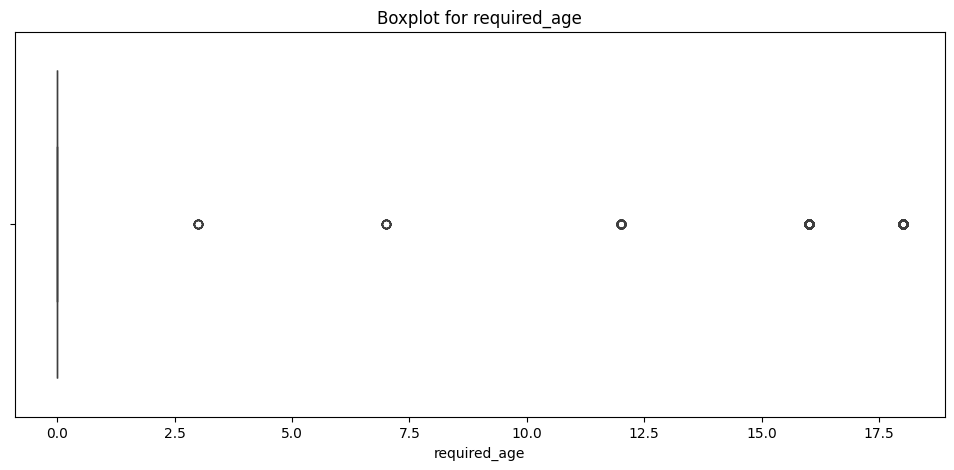

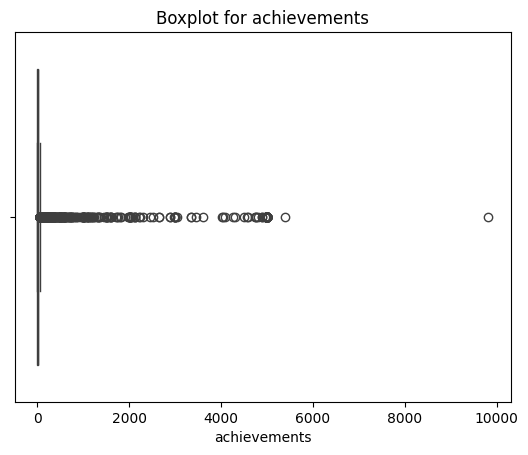

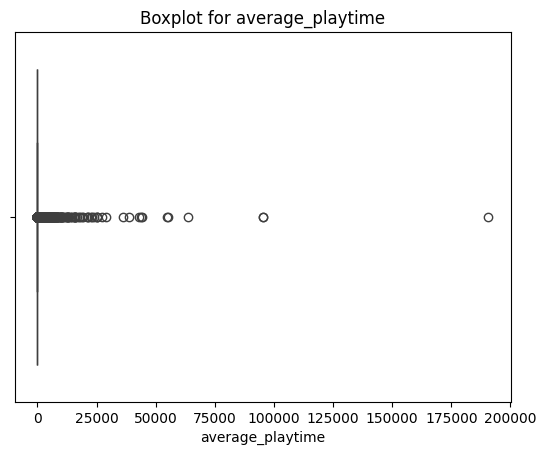

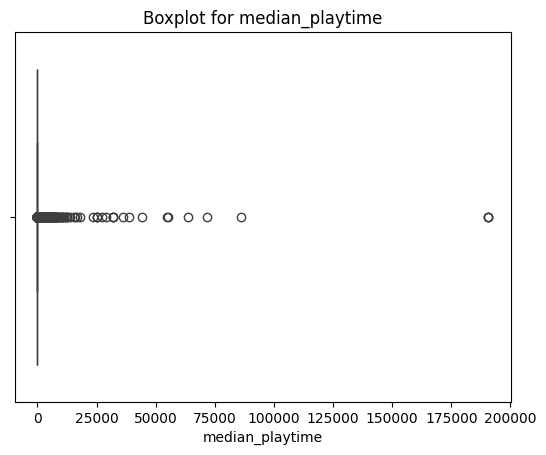

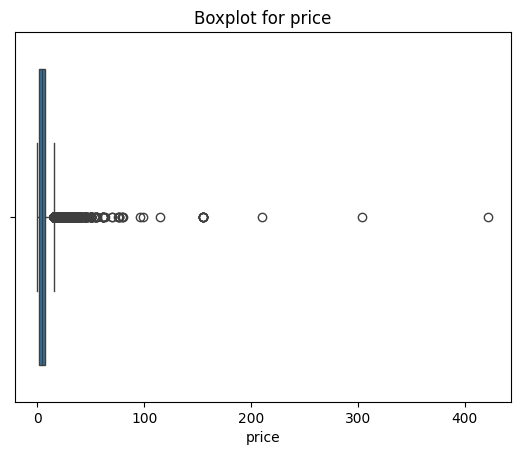

In [61]:
numeric_features = ['required_age', 'achievements', 'average_playtime', 'median_playtime', 'price']

boxplot_per_feature(steam, numeric_features)

for these outliers they'll get removed, but for required age it'll be dropped since seems like there's only 594 games with age requirement

In [62]:
def remove_outliers(df, features):
  """
  remove features outliers from dff
  """
  Q1 = df[features].quantile(0.25)
  Q3 = df[features].quantile(0.75)
  IQR = Q3 - Q1
  df = df[~((df[features] < (Q1 - 1.5 * IQR)) | (df[features] > (Q3 + 1.5 * IQR))).any(axis=1)]
  return df

In [63]:
steam_temp = remove_outliers(steam, numeric_features)

conclusions:

achievements has new outliers but this is fine, it happened since the dataframe has changed

we can see that average and median playtime got removed totaly, and looking at the original dataframe not many games have a value greater than 0, these two features will remain unchanged for lack of data(?)

price values are very low now, but comparing to original dataframe not many games are with a value above 15

for required_age it will remain unchanged because not many games has required age above 0, and the max is 18 which is totally normal


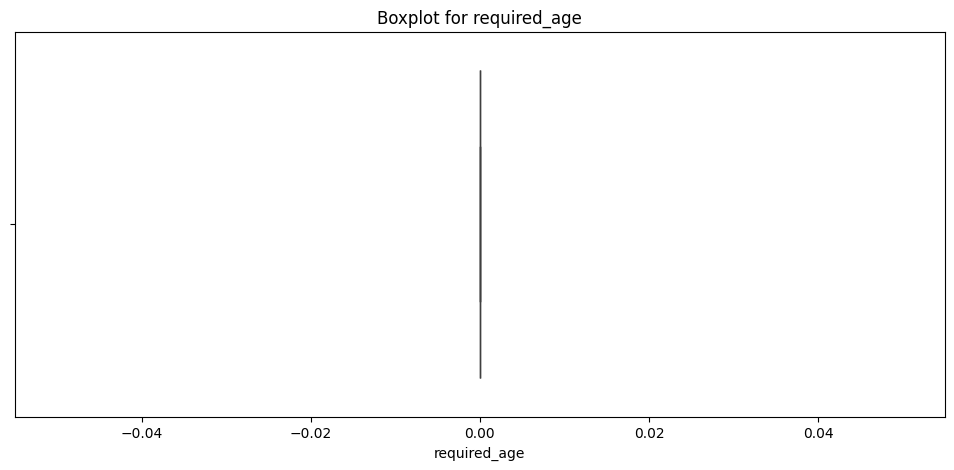

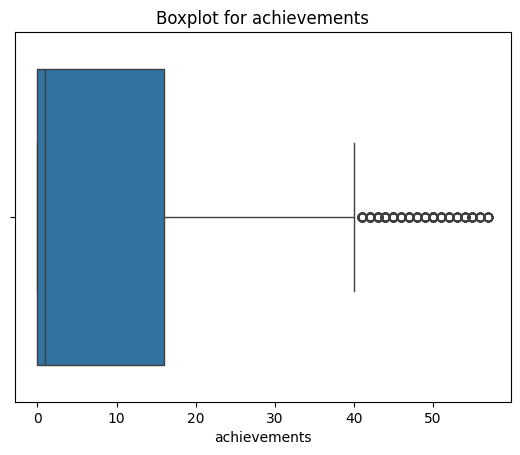

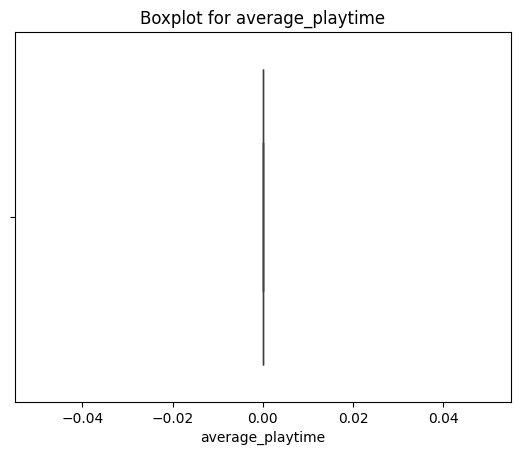

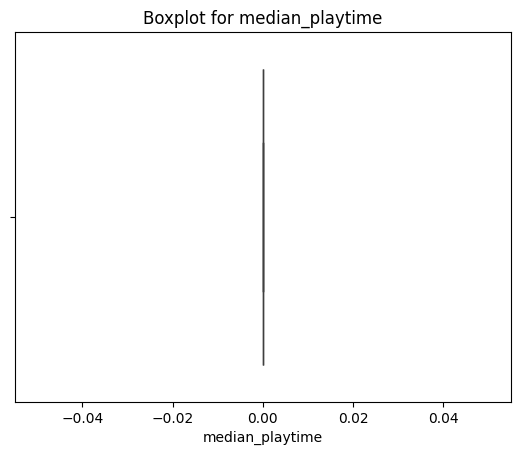

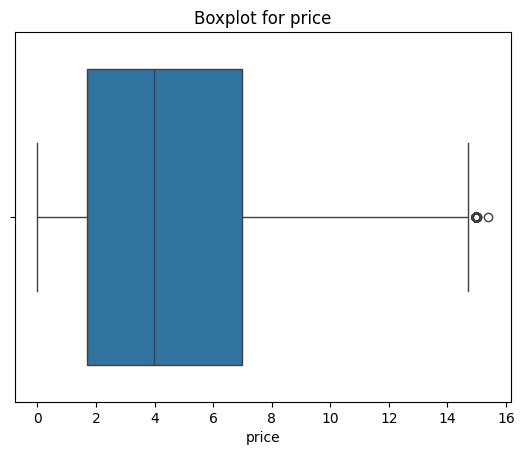

In [64]:
boxplot_per_feature(steam_temp, numeric_features)

In [65]:
print(len(df[df['median_playtime'] > 0]))
print(len(df[df['average_playtime'] > 0]))
print(len(df[df['price'] > 15]))

6170
6170
1976


In [66]:
steam = remove_outliers(steam, ['achievements', 'price'])

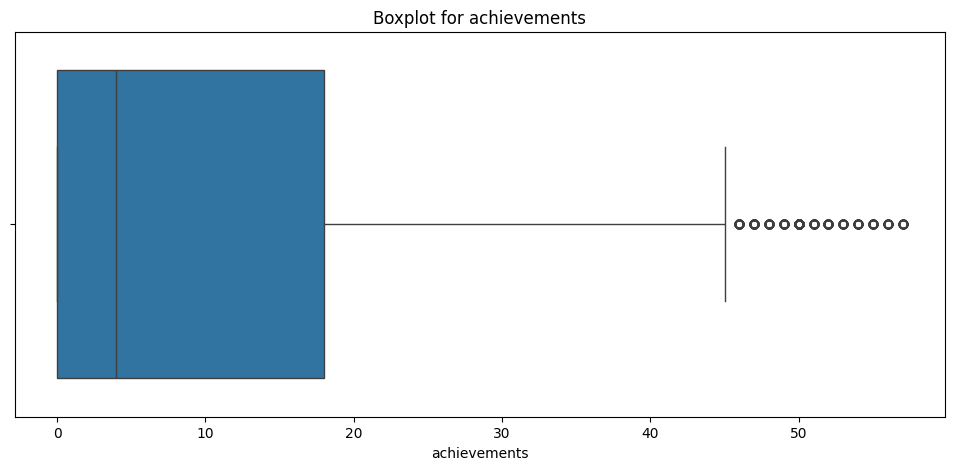

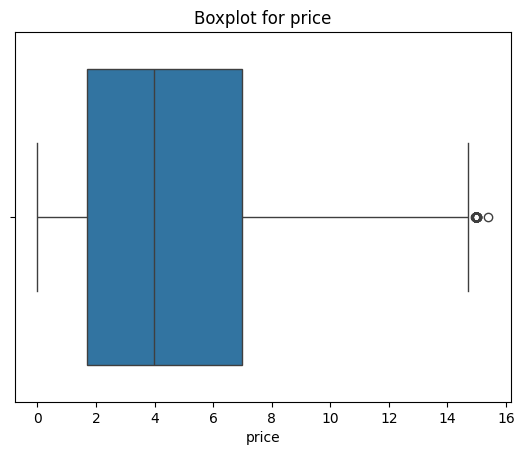

In [67]:
boxplot_per_feature(steam, ['achievements', 'price'])

### Statistical analysis after cleaning

In [68]:
steam.describe()

,required_age,achievements,average_playtime,median_playtime,price,year
count,23652.000000,23652.000000,23652.000000,23652.000000,23652.000000,23652.000000
mean,0.258752,10.683029,109.940851,113.044267,4.627074,2016.482031
std,2.049475,13.831516,1797.566154,2371.527541,3.793790,2.168842
min,0.000000,0.000000,0.000000,0.000000,0.000000,1997.000000
25%,0.000000,0.000000,0.000000,0.000000,1.690000,2016.000000
50%,0.000000,4.000000,0.000000,0.000000,3.990000,2017.000000
75%,0.000000,18.000000,0.000000,0.000000,6.990000,2018.000000
max,18.000000,57.000000,190625.000000,190625.000000,15.400000,2019.000000


In [69]:
steam.info()

<class 'pandas.core.frame.DataFrame'>
Index: 23652 entries, 0 to 27074
Data columns (total 16 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   english           23652 non-null  category
 1   required_age      23652 non-null  int64   
 2   achievements      23652 non-null  int64   
 3   average_playtime  23652 non-null  int64   
 4   median_playtime   23652 non-null  int64   
 5   owners            23652 non-null  category
 6   price             23652 non-null  float64 
 7   indie             23652 non-null  category
 8   action            23652 non-null  category
 9   adventure         23652 non-null  category
 10  singleplayer      23652 non-null  category
 11  multiplayer       23652 non-null  category
 12  rating            23652 non-null  category
 13  day               23652 non-null  category
 14  month             23652 non-null  category
 15  year              23652 non-null  int32   
dtypes: category(10), float64(1)

### Exporting cleaned dataframe to CSV

In [70]:
steam.to_csv('steam_adjusted.csv', sep=',')

# Exploratory Data Analysis

## Feature correlation

# Numerical Feature Correlation Analysis



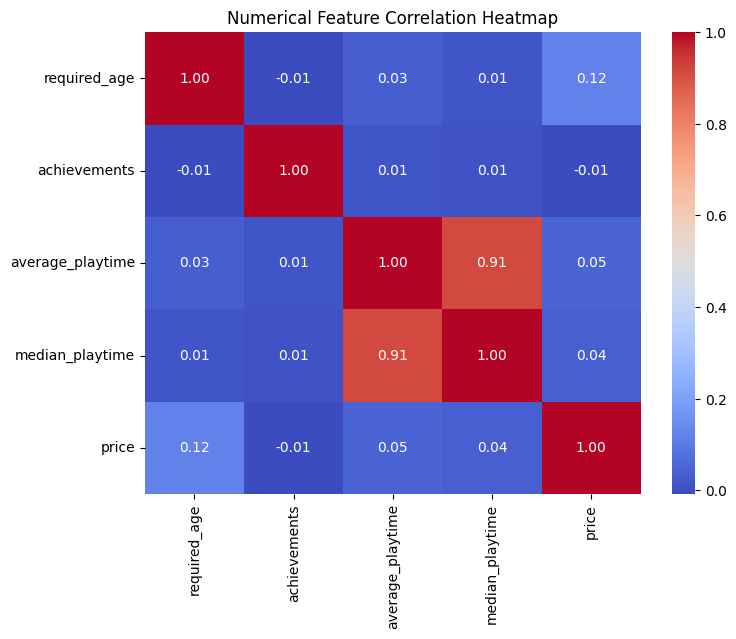

In [71]:
import seaborn as sns
import matplotlib.pyplot as plt

df['owners'] = df['owners'].replace({'10000000-20000000': 15000000,
                                     '5000000-10000000': 7500000})

# Compute correlation matrix for numerical features
numerical_features = ['positive_ratings', 'negative_ratings', 'price', 'owners', 'achievements']
df_numeric = df[numeric_features].apply(pd.to_numeric, errors='coerce')
correlation_matrix = df_numeric.corr()

# Plot correlation heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Numerical Feature Correlation Heatmap")
plt.show()


### **Key Observations:**
- **Positive Ratings and Owners** show a strong positive correlation, suggesting more popular games tend to receive more positive reviews.
- **Negative Ratings and Owners** show a weak correlation, meaning popularity does not necessarily lead to negative reviews.
- **Price and Achievements** have a minor correlation, indicating that more expensive games do not always have more achievements.

This analysis helps us understand how numerical features influence our target variable (**Rating**).

### Correlation matrix for numeric features

the only positive correlation between the numeric features is between average_playtime and median_playtime, which doesn't say much since by nature the average and median are usualy related

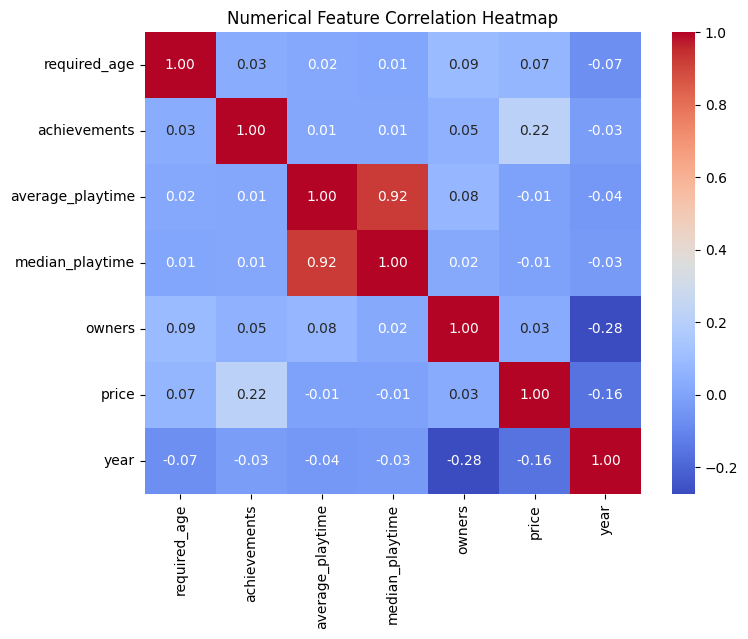

In [72]:
# Convert "owners" ranges to approximate midpoint numbers
steam['owners'] = steam['owners'].astype(str)

owners_mapping = {
    '0-20000': 10000,
    '20000-50000': 35000,
    '50000-100000': 75000,
    '100000-200000': 150000,
    '200000-500000': 350000,
    '500000-1000000': 750000,
    '1000000-2000000': 1500000,
    '2000000-5000000': 3500000,
    '5000000-10000000': 7500000,
    '10000000-20000000': 15000000
}

steam['owners'] = steam['owners'].replace(owners_mapping)  
steam['owners'] = pd.to_numeric(steam['owners'], errors='coerce')  # Ensure numeric type


numeric_cols = steam.select_dtypes(include=['number'])
corrMatrix = numeric_cols.corr()

# Display correlation heatmap
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8,6))
sns.heatmap(corrMatrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Numerical Feature Correlation Heatmap")
plt.show()


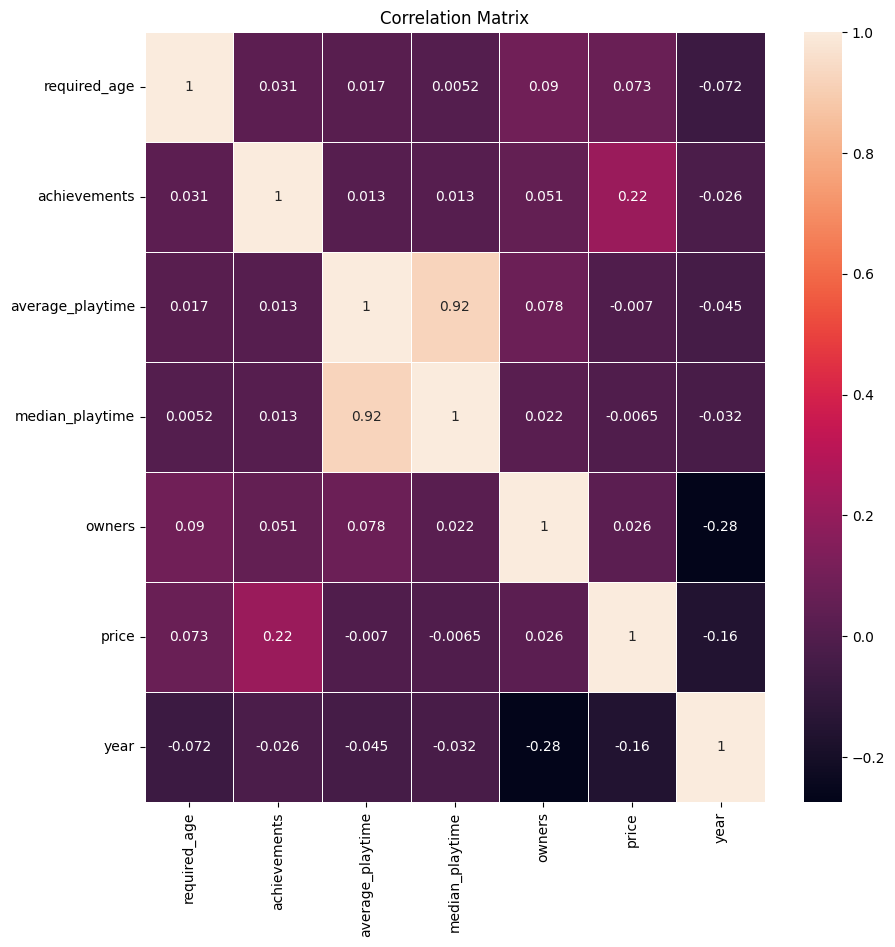

In [73]:
fig, ax = plt.subplots(figsize=(10,10))
ax.set_title('Correlation Matrix')
sns.heatmap(corrMatrix, annot=True, linewidth=.5, ax=ax)
plt.show()

In [74]:
numeric_features = ['required_age', 'achievements', 'average_playtime', 'median_playtime', 'price', 'year']

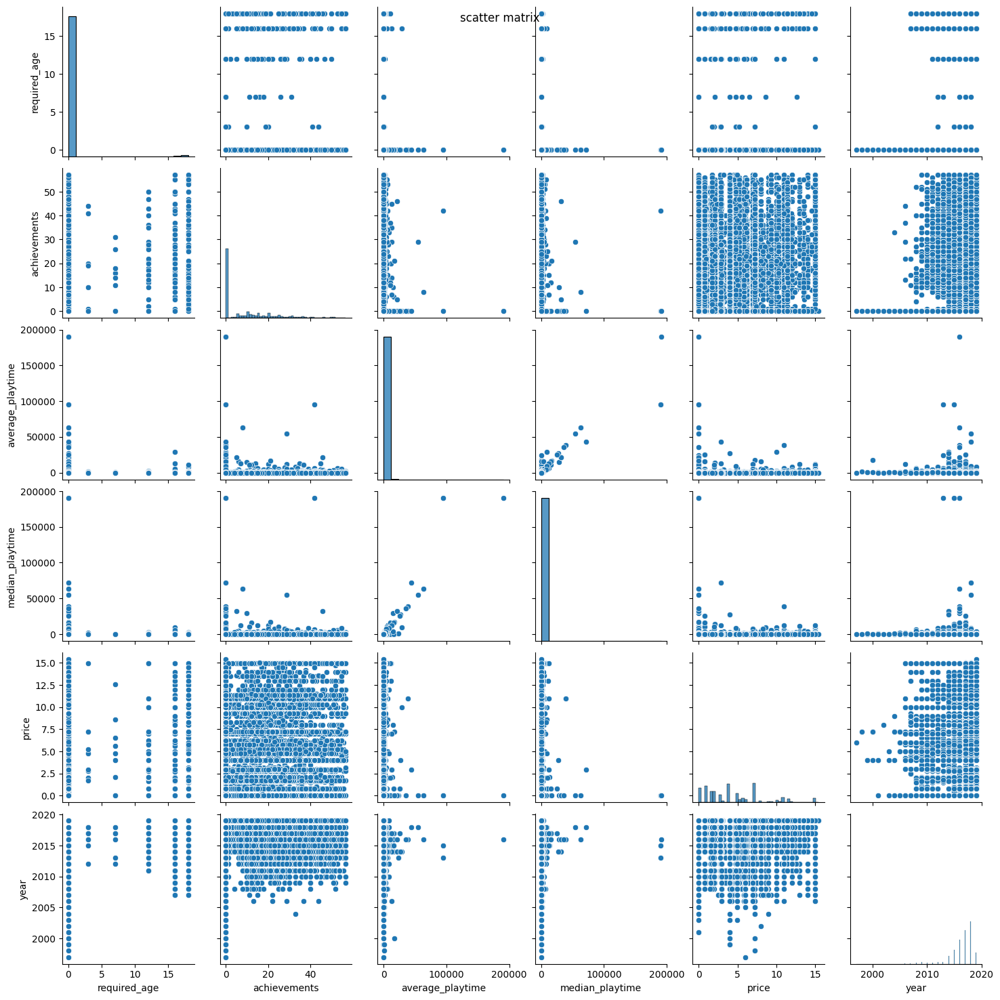

In [75]:
steam_temp = steam[numeric_features]

sns.pairplot(steam_temp)
plt.suptitle('scatter matrix')
plt.show()

### Correlation between categorical to price

In [76]:
categorical_features = ['english', 'owners', 'indie', 'action', 'adventure', 'singleplayer', 'multiplayer', 'rating', 'day', 'month']

the visible correlation are: 
1.    between english and price, the non english games are priced lower
2.    between the rating and price, the negative rating games have lower price highs opposed to the positive rating games
3.    games featuring singleplayer are priced higher than these which don't

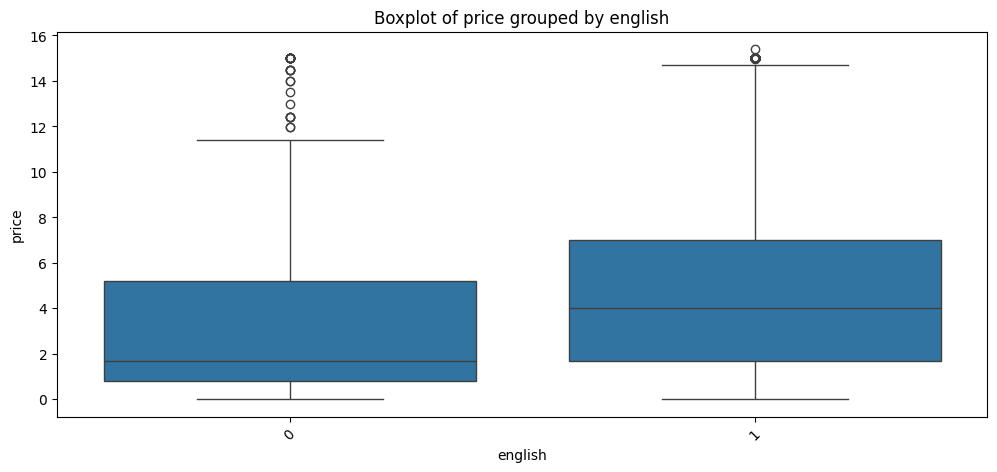

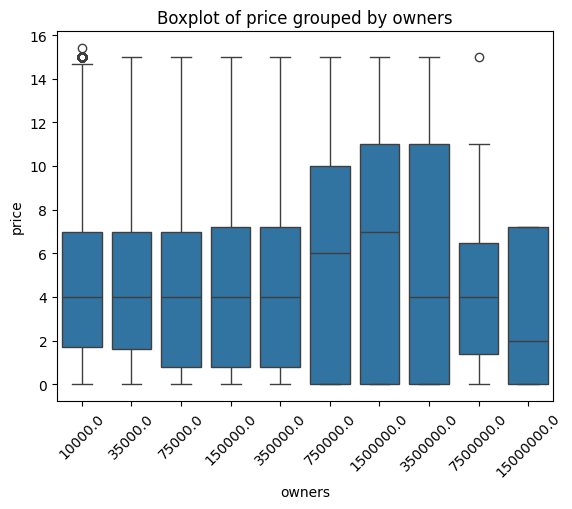

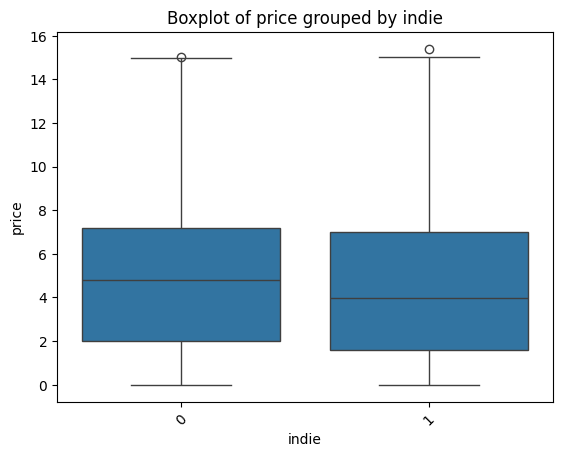

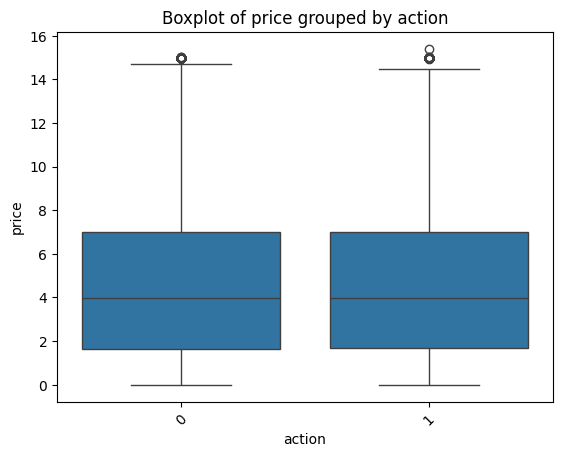

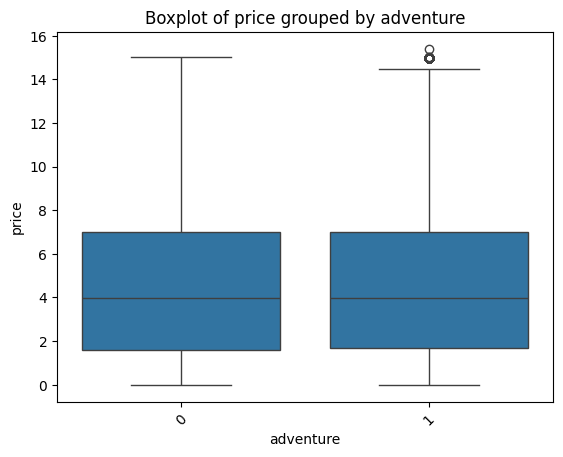

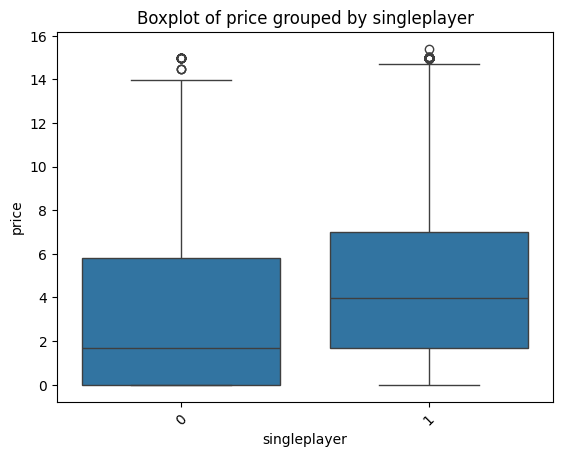

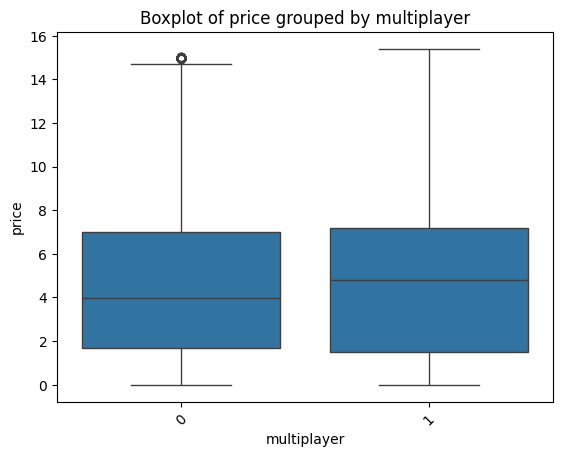

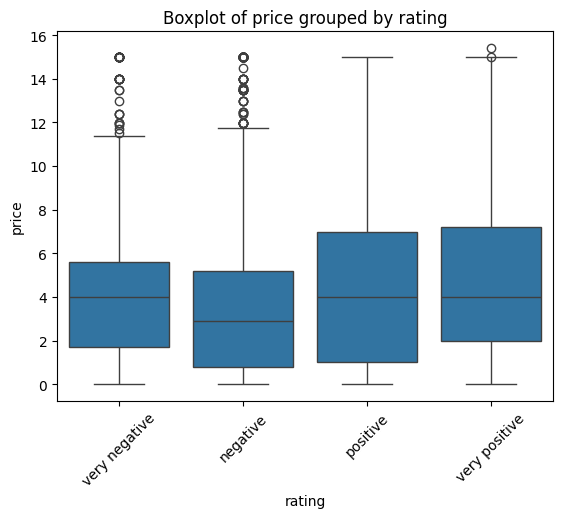

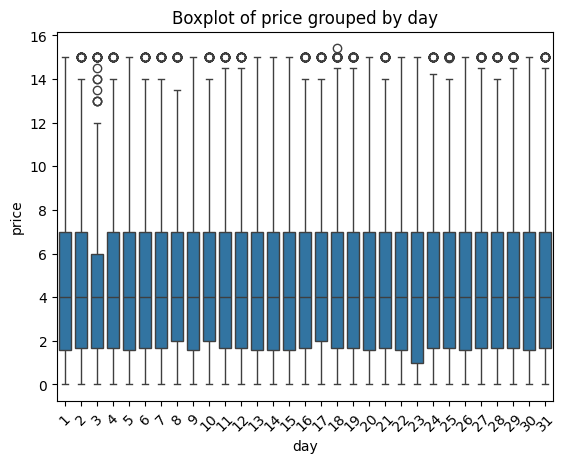

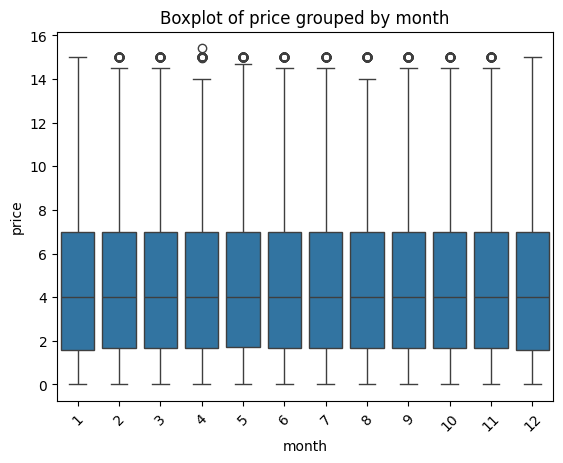

In [77]:
boxplots_sameFeature(steam, categorical_features, 'price')

### Correlation between categorical to achievements

Observations:

1.    english games have more achievements than these which aren't english
2.    indie games have more achievements than these which aren't indie
3.    singleplayer games have more achievements than non singleplayer games
4.    the higher the game rating the more achievements it has. This could mean that games that have more achievements get better rating

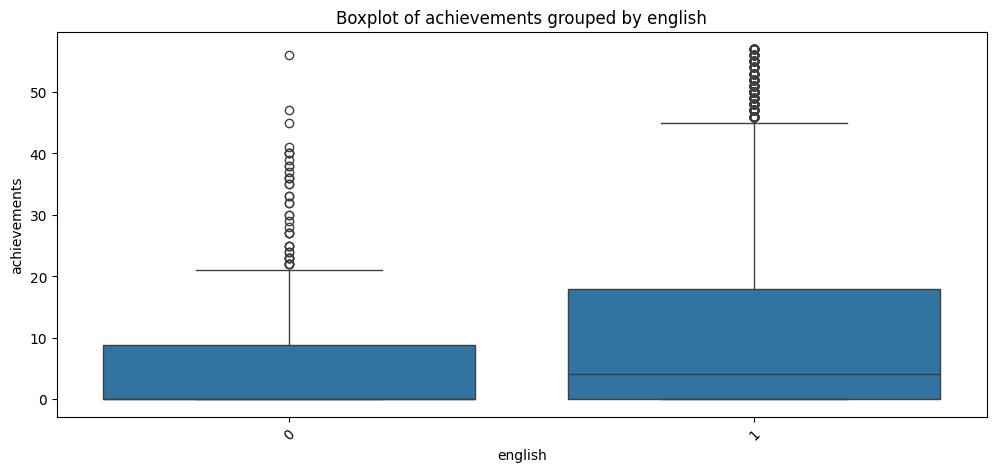

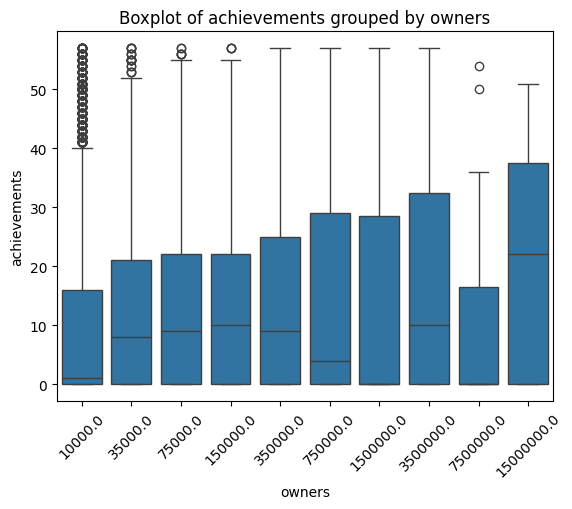

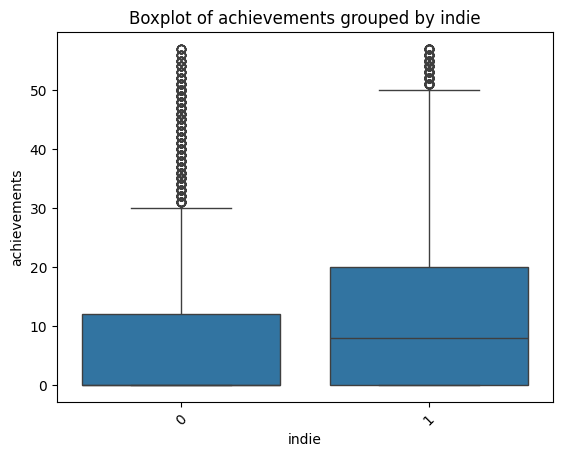

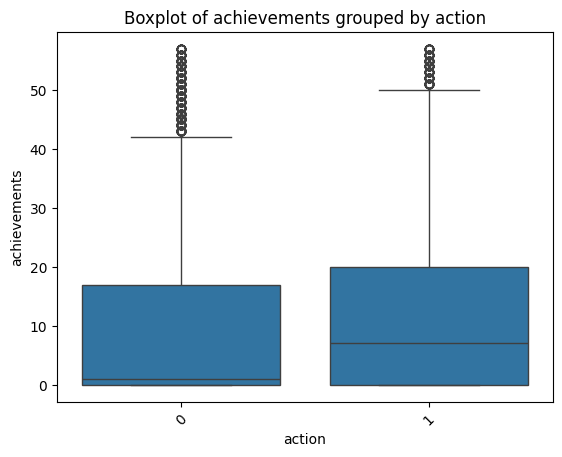

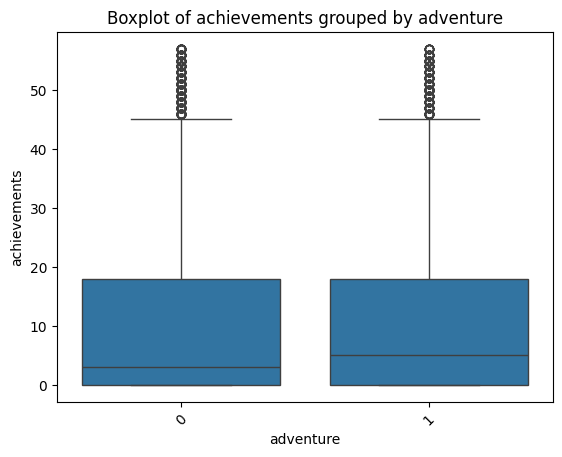

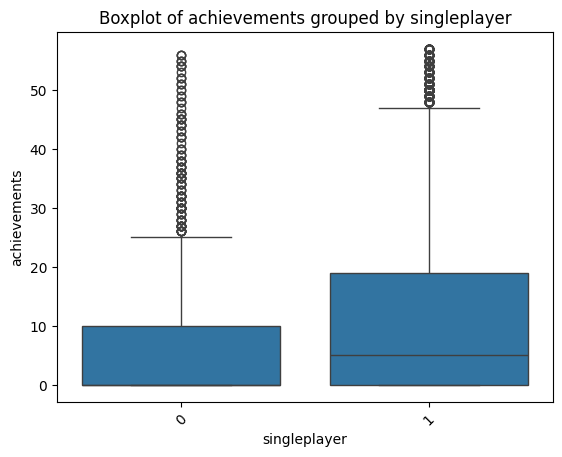

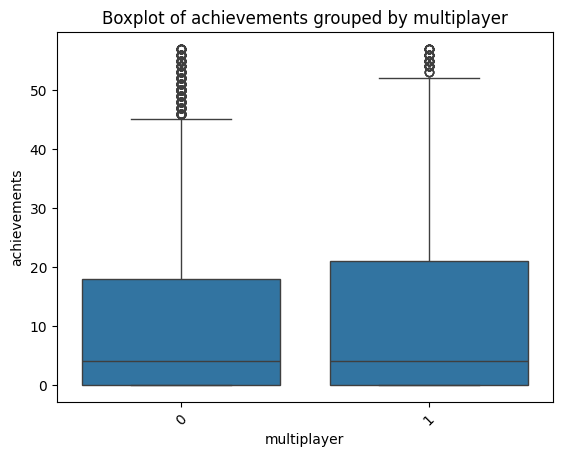

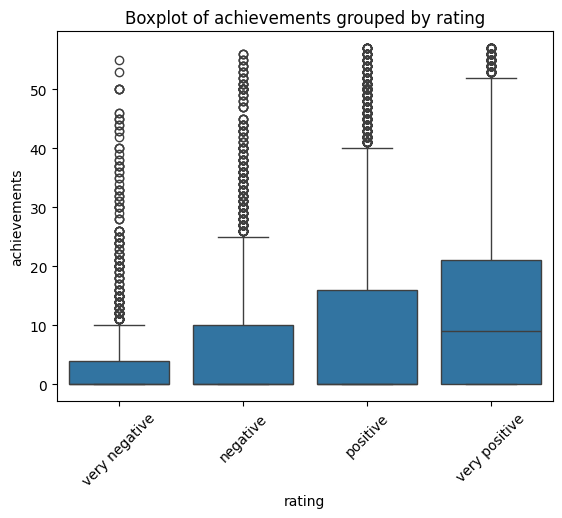

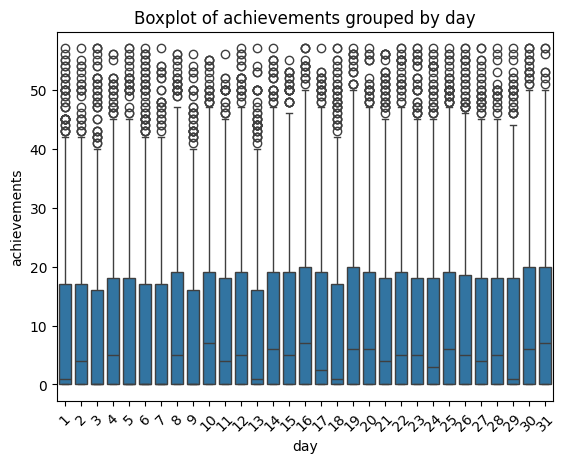

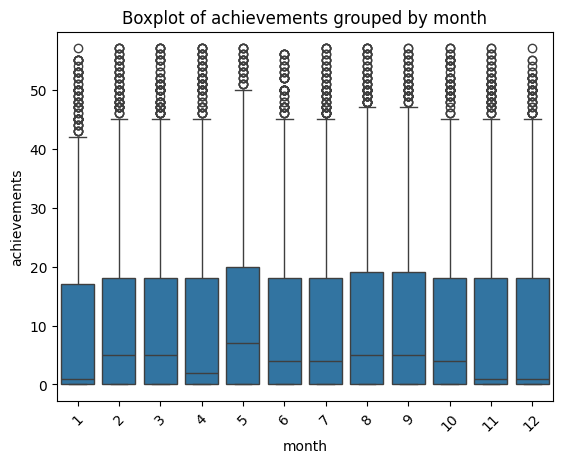

In [78]:
boxplots_sameFeature(steam, categorical_features, 'achievements')

## Analysis of each feature

before we dive into each feature, an overall look at rating, we can see that most games very positive and positive

Text(0.5, 1.0, 'countplot for rating')

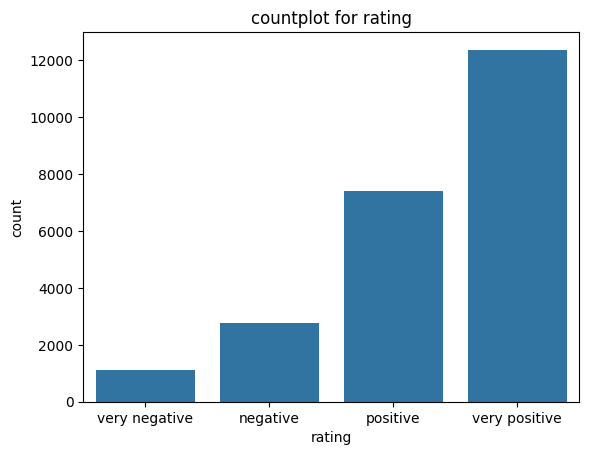

In [79]:
sns.countplot(data=steam, x="rating")
plt.title("countplot for rating")

### Numeric features

In [80]:
def create_histplots(df, features, hue):
  """
  create a histplot for feature in df with hue
  """
  plt.figure(figsize=[25,25])
  index = 1
  for feature in features:
    plt.subplot(5, 5, index)
    sns.histplot(data=steam, x=feature, hue=hue)
    plt.title(feature + ' Histogram')
    index += 1

Observation:

1.    **required_age** - has mostly values only in 0
2.    **achievements** - most games have no achievments, then the most either have 10, 15 or 20 achievements
3.    **average_playtime, median_playtime** - as mentioned before, most values are 0, seems like there's a lack of data in these features
4.    **price** - the price doesn't have a specific distribution, but we can see that the higher the price the better the rating
5.    **year** - we can see that the number of games risen since 2014, with the highest peak at 2018

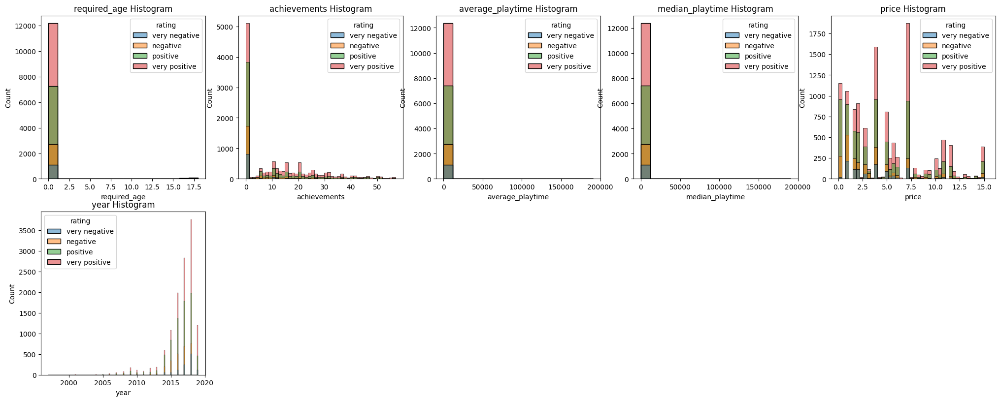

In [81]:
create_histplots(steam, numeric_features, 'rating')

### Categorical features

In [82]:
def create_countplot(df, features):
  """
  create a countplot for feature in df with hue
  """
  plt.figure(figsize=[25,25])
  index = 1
  for feature in features:
    plt.subplot(5, 5, index)
    sns.countplot(data=steam, x=feature)
    plt.title(feature + ' catplot')
    index += 1

Observation:

1.   **owners** - there is less games the higher the owners count goes up
2.   **indie** - there is much more indie games that there isn't
3.   **action, adventure** - both are distributed about equally, except there is a little more non-action/non-adventure games than there is action/adventure games
4.    **singleplayer** - most games are singleplayer while only a little bit of games don't have singleplayer
5.    **multiplayer** - this is mostly the opposite of singleplayer, where most games don't have multiplayer
6.    **rating** - as we have obsereved before, there is more positive rating games than negative
7.    **day, month** - the distrubtion of these two features is more or less uniform

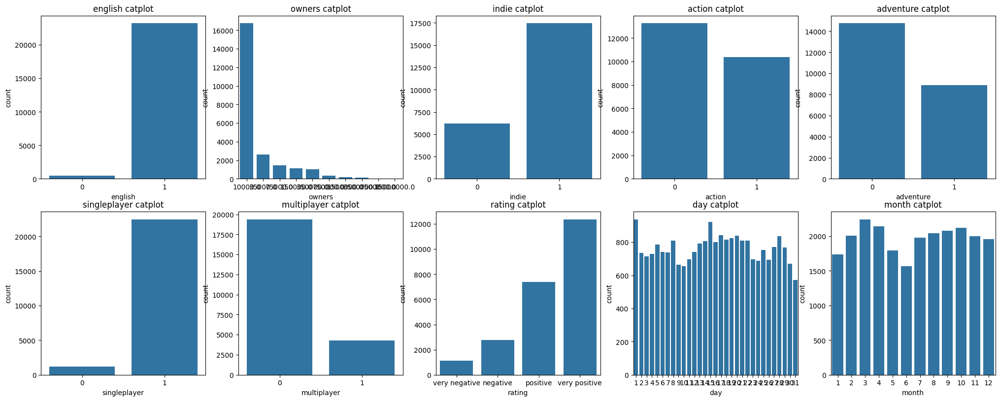

In [83]:
create_countplot(steam, categorical_features)

## Visualization for relevant and interesting features

### Some observation charts

English to non english games

In [84]:
fig = go.Figure(data=[go.Pie(labels=steam['english'].value_counts().index, 
                             values=steam['english'].value_counts().values)])

fig.update_traces(textinfo='value', textfont_size=20)

fig.update_layout(
    height=600, width=600, title_text='English and non English games', 
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=-0.2,
            xanchor="right",
            x=1)
)

fig.show()

Free to non free games

In [85]:
free, not_free = steam[steam['price'] == 0].shape[0], steam[steam['price'] != 0].shape[0]

labels = ['free', 'not free']
fig = go.Figure(data=[go.Pie(labels=labels, values=[free, not_free])])

fig.update_traces(textinfo='value', textfont_size=20)

fig.update_layout(
    height=600, width=600, title_text='Free and not free games',
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=-0.2,
            xanchor="right",
            x=0.75)
)

fig.show()

game releases per year

In [86]:
fig = go.Figure()

fig.add_trace(go.Bar(x = steam['year'].value_counts().index[:12],
                     y  = steam['year'].value_counts().values[:12]))

fig.update_layout(
    height=600, width=500, title_text='Steam games per year'
)

fig.show()

### price of games over years / months

we can see that early yeras the games where price around the middle, but the more years have passed by , the more ranged the prices have become

Text(0.5, 1.0, 'price x year')

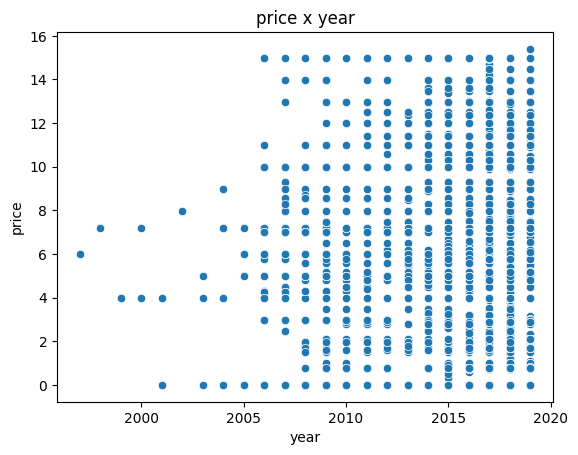

In [87]:
sns.scatterplot(data=steam, x="year", y="price")
plt.title('price x year')

the month the game has released doesn't seem to affect the price of the game

Text(0.5, 1.0, 'price x month')

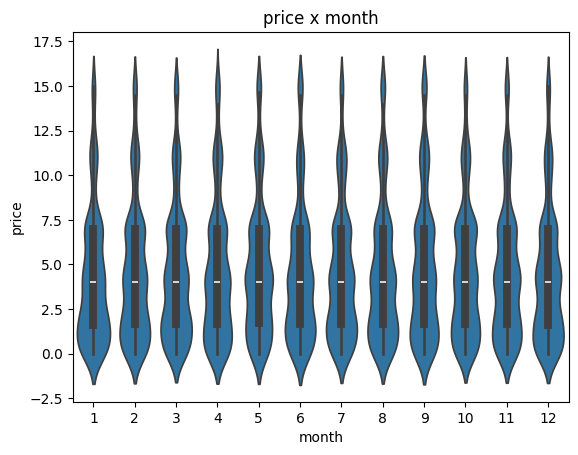

In [88]:
sns.violinplot(data=steam, y='price', x='month')
plt.title('price x month')

games that have singleplayer price higher than these that don't

Text(0.5, 1.0, 'price x singleplayer')

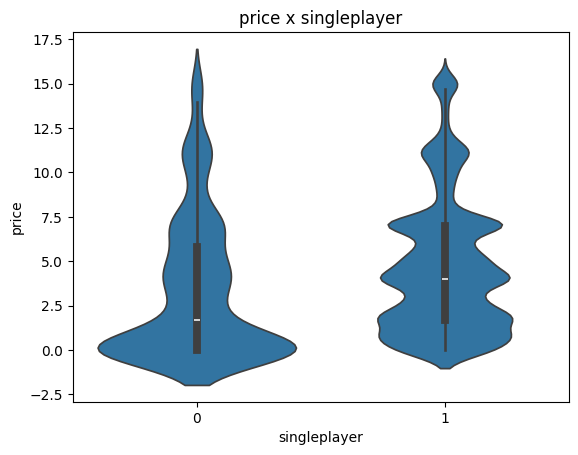

In [89]:
sns.violinplot(data=steam, y='price', x='singleplayer')
plt.title('price x singleplayer')

games that don't have multiplayer seem to have usually lower price, as for games that do have multiplayer have a "more uniform" price distrubtion

Text(0.5, 1.0, 'price x multiplayer')

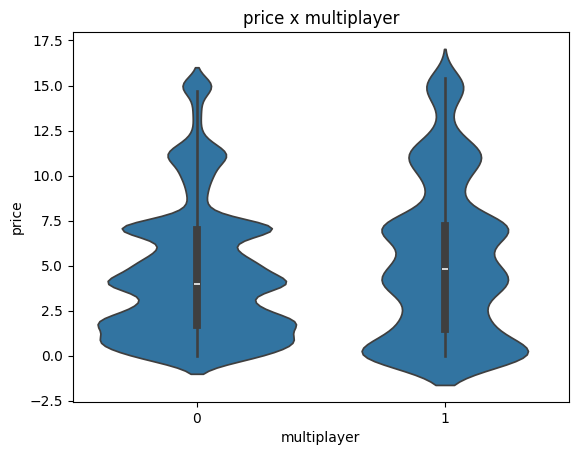

In [90]:
sns.violinplot(data=steam, y='price', x='multiplayer')
plt.title('price x multiplayer')

### achievements against singleplayer / multiplayer / indie / action / adventure / price

as we've seen before, most games have 0 achievements, next most common number is 10, 15 and 20, but according to the violin plot, 10 seems the 2nd common

Text(0.5, 1.0, 'achievements violin')

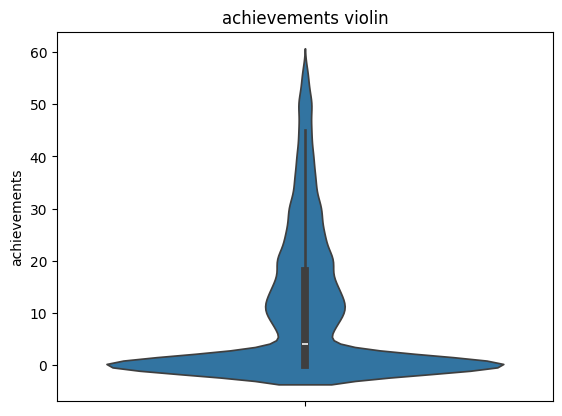

In [91]:
sns.violinplot(data=steam, y='achievements')
plt.title('achievements violin')

we can see that the more achievements there is, the higher the rating is ! (looked at values where achievements is greater than 0)

Text(0.5, 1.0, 'achievements > 0 x rating')

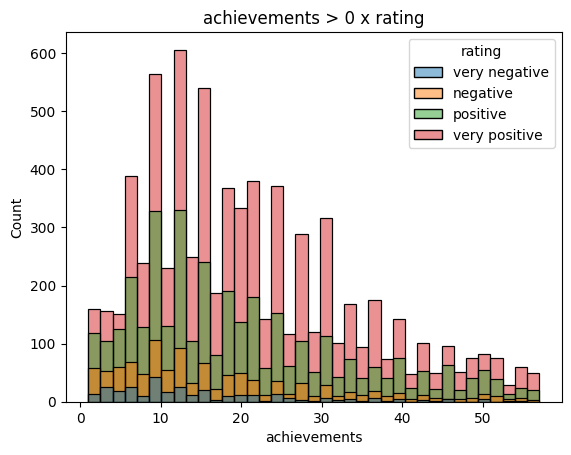

In [92]:
sns.histplot(data=steam[steam['achievements'] > 0], x='achievements', hue='rating')
plt.title('achievements > 0 x rating')

while we did observe before that singleplayer games tend to have more achievements, with the violin plot we can see that the singleplayer games are bringing the number of games with 10 achievements up

Text(0.5, 1.0, 'achievements x singleplayer')

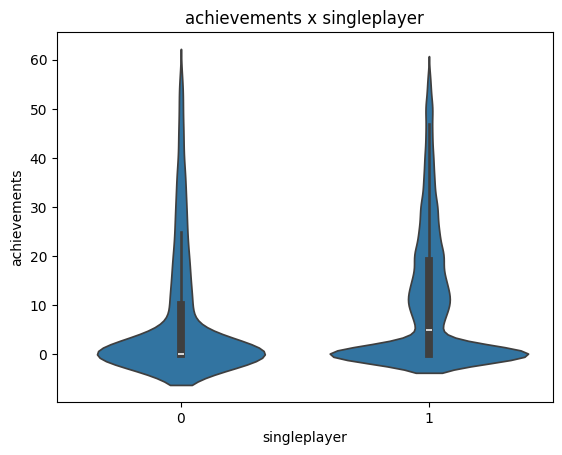

In [93]:
sns.violinplot(data=steam, y='achievements', x='singleplayer')
plt.title('achievements x singleplayer')

we can see that the games with no multiplayer have more achievement but only slightly, it is not as dramatic as singleplayer

Text(0.5, 1.0, 'achievements x multiplayer')

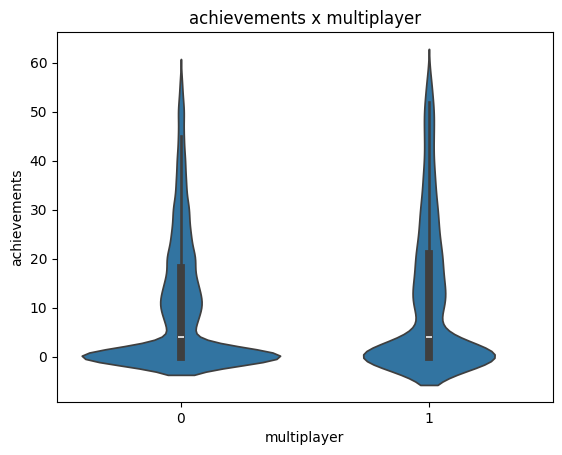

In [94]:
sns.violinplot(data=steam, y='achievements', x='multiplayer')
plt.title('achievements x multiplayer')

indie games have a more drastic relation to achievements, where indie games tend to have achievements where as non indie games mostly have no achievements

Text(0.5, 1.0, 'achievements x indie')

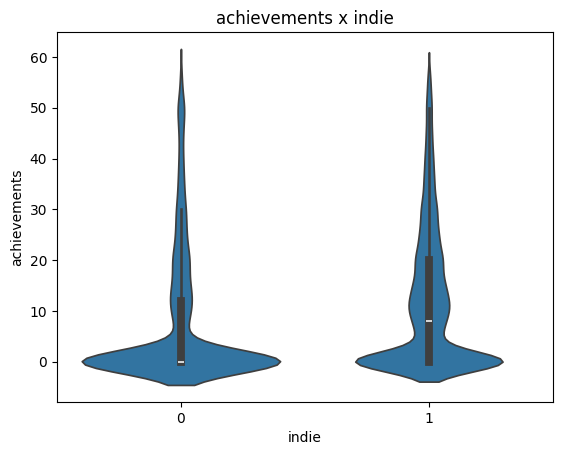

In [95]:
sns.violinplot(data=steam, y='achievements', x='indie')
plt.title('achievements x indie')

there doesn't seem to be a relation between achievements and action

Text(0.5, 1.0, 'achievements x action')

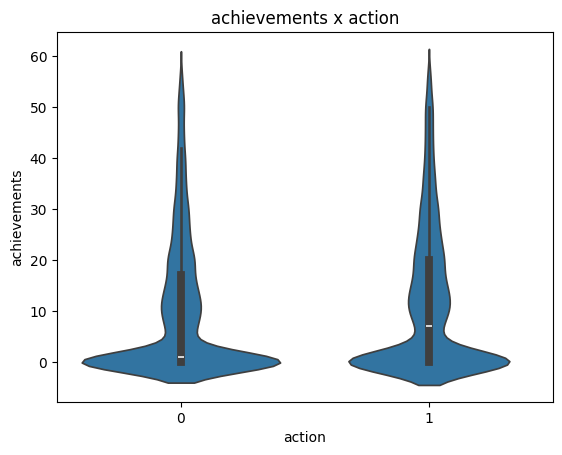

In [96]:
sns.violinplot(data=steam, y='achievements', x='action')
plt.title('achievements x action')

there doesn't seem to be a relation between achievements and adventure

Text(0.5, 1.0, 'achievements x adventure')

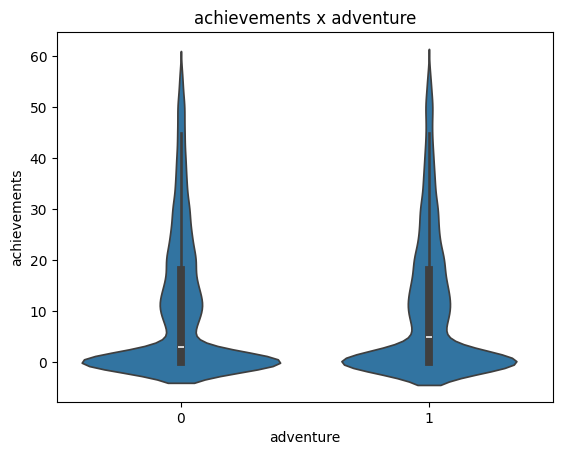

In [97]:
sns.violinplot(data=steam, y='achievements', x='adventure')
plt.title('achievements x adventure')

also there doesn't look like there's a connection between achievements and price of the game

<Axes: xlabel='achievements', ylabel='price'>

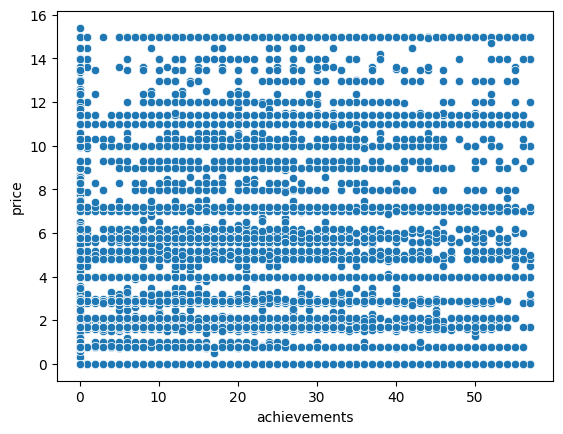

In [98]:
sns.scatterplot(data=steam, x="achievements", y="price")

### pairplot

Text(0.5, 1.0, 'pair plot')

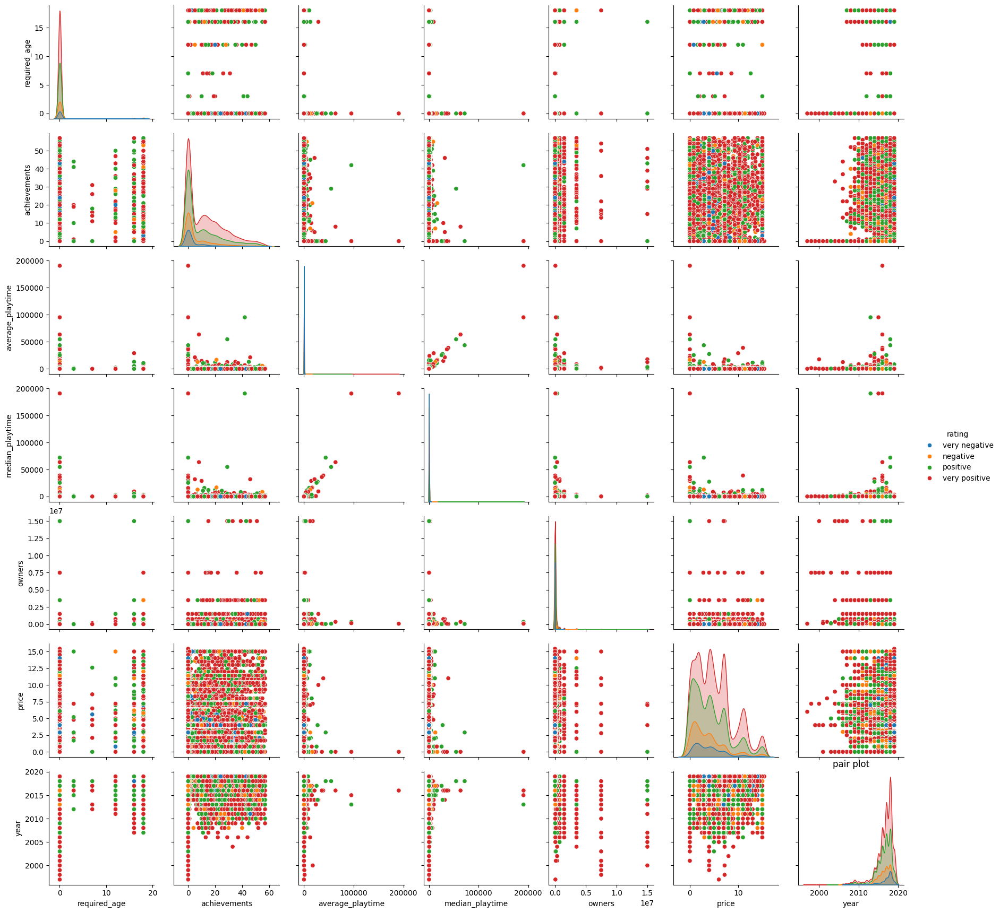

In [99]:
sns.pairplot(data=steam, hue='rating')
plt.title('pair plot')

## Additional data cleansing performed based on deeper data exploration

at first I've kept the required age feature thinking there could be a connection between it to other features, but since there doesn't seem to be and most games don't have a required age, we can drop the feature

In [100]:
steam.drop(columns=['required_age'], inplace=True)

# Classification Model

In [101]:
from sklearn.naive_bayes import GaussianNB
import sklearn as skl
from sklearn.tree import DecisionTreeClassifier # Import Decision Tree Classifier
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import metrics #Import scikit-learn metrics module for accuracy calculation
import pydotplus
import numpy

## Gaussian Naïve Bayes

We'll be looking at Gaussian Naïve Bayes with the features 'achievements' and 'indie'

these two features seems best appropriate for the rating according to previous observations, where the more achievements an indie game had the more rating it got

In [102]:
def bayes_plot(df, model='gnb', spread=30):
  df.dropna()
  colors = 'seismic'
  col1 = df.columns[0]
  col2 = df.columns[1]
  target = df.columns[2]
  sns.scatterplot(data=df, x=col1, hue=target)
  plt.title(f'{col1} for {col2}')
  plt.show()
  y = df[target]
  x = df.drop(target, axis=1)

  x.columns = x.columns.astype(str)  # Convert to string format (ensures valid feature names)

  x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=1)

  clf = GaussianNB()
  if model != 'gnb':
      clf = DecisionTreeClassifier(max_depth=model)

  clf = clf.fit(x_train, y_train)

  # Ensure test data matches training data format
  x_test = pd.DataFrame(x_test, columns=x_train.columns)
  y_pred = clf.predict(x_test)

  print(metrics.classification_report(y_test, y_pred, zero_division=1))

  hueorder = clf.classes_

  x_min, x_max = x.loc[:, col1].min() - 1, x.loc[:, col1].max() + 1
  y_min, y_max = x.loc[:, col2].min() - 1, x.loc[:, col2].max() + 1
  xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.2),
                       np.arange(y_min, y_max, 0.2))
  
  prob = len(clf.classes_) == 2
  z = clf.predict_proba(pd.DataFrame(np.c_[xx.ravel(), yy.ravel()], columns=x_train.columns))
  if prob:
    z = z[:, 1]-z[:, 0]
  else:
    colors = 'Set1'
    z = np.argmax(z, axis=1)
  
  z = z.reshape(xx.shape)
  plt.contourf(xx, yy, z, cmap=colors, alpha=0.5)
  plt.colorbar()
  plt.title('countour plot')
  if not prob:
    plt.clim(0, len(clf.classes_)+3)
  sns.scatterplot(data=df[::spread], x=col1, y=col2, hue=target, hue_order=hueorder, palette=colors)
  fig = plt.gcf()
  fig.set_size_inches(12, 8)
  plt.title('2d scatter for gnb')
  plt.show()

In [103]:
x_steam = steam[['indie', 'achievements']]
y_steam = steam['rating']

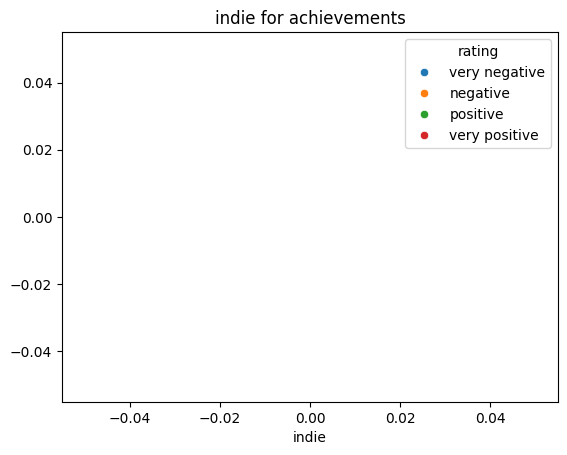

               precision    recall  f1-score   support

     negative       1.00      0.00      0.00       790
     positive       1.00      0.00      0.00      2289
very negative       1.00      0.00      0.00       339
very positive       0.52      1.00      0.68      3678

     accuracy                           0.52      7096
    macro avg       0.88      0.25      0.17      7096
 weighted avg       0.75      0.52      0.35      7096



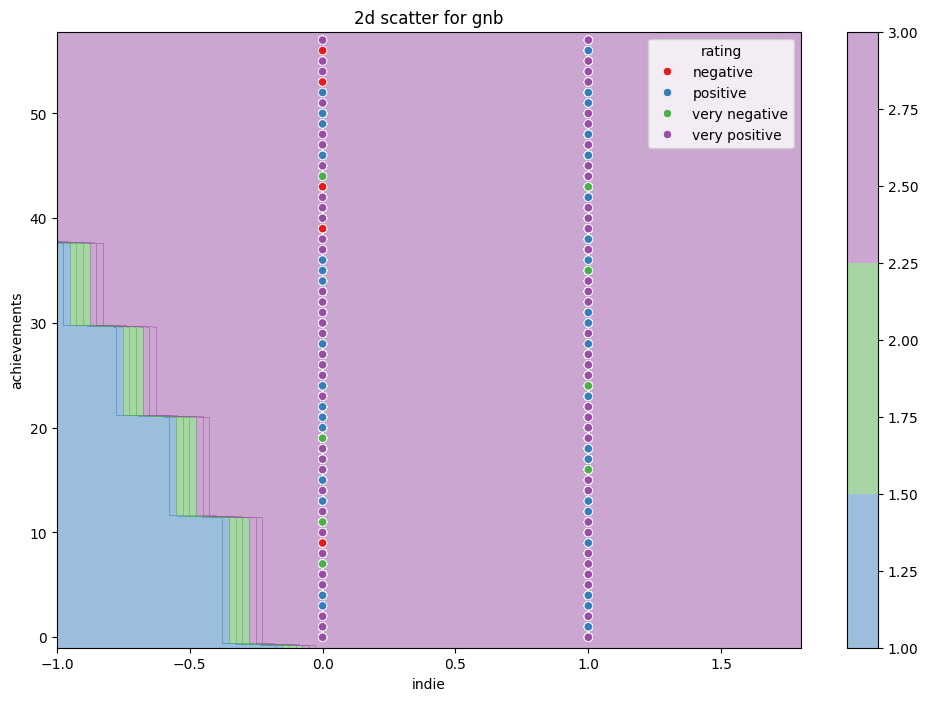

In [104]:
bayes_plot(pd.concat([x_steam,y_steam],axis=1),spread=1)

## Decision Tree

In [105]:
from sklearn import tree
from sklearn.metrics import classification_report
from sklearn.inspection import permutation_importance
from sklearn.metrics import ConfusionMatrixDisplay 
from io import StringIO
from IPython.display import Image
from sklearn.tree import export_graphviz

In [106]:
def create_decision_tree(features, target, classes, max_depth=None, min_impurity_decrease=0.0, max_leaf_nodes=None, min_samples_split=2):
    """
    Create decision tree for features with a criterion.
    """
    x_train, x_test, y_train, y_test = train_test_split(features, target, test_size=0.3, random_state=1)
    clf = DecisionTreeClassifier(random_state=1, max_depth=max_depth, min_impurity_decrease=min_impurity_decrease, 
                                 max_leaf_nodes=max_leaf_nodes, min_samples_split=min_samples_split)
    clf.fit(x_train, y_train)
    y_pred = clf.predict(x_test)

    # Fix: Add zero_division=1 to avoid precision errors
    report_result = classification_report(y_test, y_pred, target_names=classes, output_dict=True, zero_division=1)

    # Display classification heatmap
    plt.figure(figsize=(8, 5))
    sns.heatmap(pd.DataFrame(report_result).iloc[:-1, :].T, annot=True)
    plt.title("Classification Report Heatmap")
    plt.show()
  
    return clf

#### replace owners with numerical values

In [107]:
classes = ['very negative', 'negative', 'positive', 'very positive']

df_original_copy['owners'] = df_original_copy['owners'].astype(str)  # Convert to string

owners_mapping = {
    '0-20000': 10000,
    '20000-50000': 35000,
    '50000-100000': 75000,
    '100000-200000': 150000,
    '200000-500000': 350000,
    '500000-1000000': 750000,
    '1000000-2000000': 1500000,
    '2000000-5000000': 3500000,
    '5000000-10000000': 7500000,
    '10000000-20000000': 15000000
}

df_original_copy['owners'] = df_original_copy['owners'].replace(owners_mapping)
df_original_copy['owners'] = pd.to_numeric(df_original_copy['owners'], errors='coerce')  # Convert to numeric

In [108]:
steam_numerical = steam.copy().replace(owners, [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13])

In [109]:
df_original_copy_numerical = df_original_copy.copy().replace(owners, [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13])

In [110]:
df_original_copy_numerical['total_reviews'] = df_original_copy_numerical['positive_ratings'] + df_original_copy_numerical['negative_ratings']

# Compute positive review percentage
df_original_copy_numerical['positive_review_percentage'] = (df_original_copy_numerical['positive_ratings'] / df_original_copy_numerical['total_reviews']) * 100

# Function to classify rating
def classify_rating(percentage):
    if percentage >= 85:
        return 'Very Positive'
    elif percentage >= 70:
        return 'Positive'
    elif percentage >= 40:
        return 'Negative'
    else:
        return 'Very Negative'

# Apply the classification function
df_original_copy_numerical['rating'] = df_original_copy_numerical['positive_review_percentage'].apply(classify_rating)

# Drop helper column
df_original_copy_numerical.drop(columns=['positive_review_percentage', 'total_reviews'], inplace=True)

print("✅ 'rating' column successfully created BEFORE train-test split!")

✅ 'rating' column successfully created BEFORE train-test split!


## a- a baseline decision tree classification report for original dataset

In [111]:
print("Columns in df_original_copy_numerical before extraction:", df_original_copy_numerical.columns)

# Ensure 'rating' exists before proceeding
if 'rating' not in df_original_copy_numerical.columns:
    print("⚠️ WARNING: 'rating' column is missing. Recalculating it now...")

    # Recalculate rating if missing
    df_original_copy_numerical['total_reviews'] = df_original_copy_numerical['positive_ratings'] + df_original_copy_numerical['negative_ratings']
    df_original_copy_numerical['positive_review_percentage'] = (df_original_copy_numerical['positive_ratings'] / df_original_copy_numerical['total_reviews']) * 100

    def classify_rating(percentage):
        if percentage >= 85:
            return 'Very Positive'
        elif percentage >= 70:
            return 'Positive'
        elif percentage >= 40:
            return 'Negative'
        else:
            return 'Very Negative'

    df_original_copy_numerical['rating'] = df_original_copy_numerical['positive_review_percentage'].apply(classify_rating)

    # Drop helper column
    df_original_copy_numerical.drop(columns=['positive_review_percentage', 'total_reviews'], inplace=True)

    print("✅ 'rating' column was missing but has now been created!")

# Convert 'release_date' to numeric 
if 'release_date' in df_original_copy_numerical.columns:
    df_original_copy_numerical['release_date'] = pd.to_datetime(df_original_copy_numerical['release_date'], errors='coerce')
    df_original_copy_numerical['release_date'] = df_original_copy_numerical['release_date'].astype('int64') // 10**9

# Convert categorical features to numerical
categorical_features = ['owners', 'english', 'categories', 'season']
for col in categorical_features:
    if col in df_original_copy_numerical.columns:
        df_original_copy_numerical[col] = df_original_copy_numerical[col].astype('category').cat.codes

# Now extract features & target
x_features_original = df_original_copy_numerical.drop(['rating'], axis=1)
y_target_original = df_original_copy_numerical['rating']


Columns in df_original_copy_numerical before extraction: Index(['release_date', 'english', 'required_age', 'achievements',
       'positive_ratings', 'negative_ratings', 'average_playtime',
       'median_playtime', 'owners', 'price',
       ...
       'genre10_Strategy', 'genre10_Utilities', 'genre11_Software Training',
       'genre11_Video Production', 'genre12_Utilities',
       'genre12_Web Publishing', 'genre13_Video Production',
       'genre14_Web Publishing', 'genre15_Game Development', 'rating'],
      dtype='object', length=487)


In [112]:
# Only proceed if variables are not None
if x_features_original is not None and y_target_original is not None:
    x_train, x_test, y_train, y_test = train_test_split(x_features_original, y_target_original, test_size=0.3, random_state=1)
else:
    raise ValueError("Cannot proceed: Features or target variable is missing.")


looking at accuracy per depth

Text(9.444444444444445, 0.5, 'accuracy')

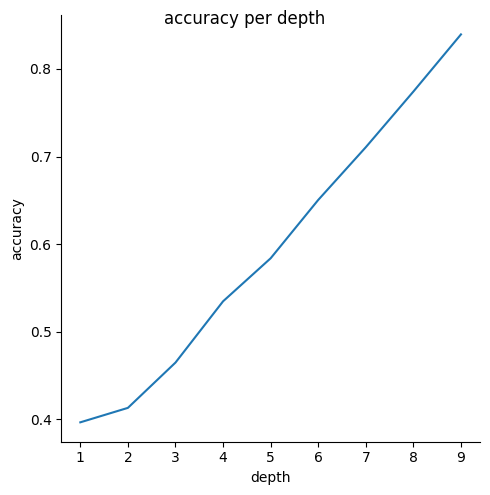

In [113]:
depths = list(range(1, 10))

x_train, x_test, y_train, y_test = train_test_split(x_features_original, y_target_original, test_size=0.3, random_state=1)
accuracy = []

for depth in depths:
  clf = DecisionTreeClassifier(max_depth = depth, random_state=1)
  clf.fit(x_train, y_train)
  score = clf.score(x_test, y_test)
  accuracy.append(score)

%matplotlib inline
ind = range(len(accuracy)) + np.ones(len(accuracy))
graph = sns.relplot(x=ind, y=accuracy, kind="line")

graph.fig.suptitle('accuracy per depth')
graph.axes[0, 0].set_xlabel('depth')
graph.axes[0, 0].set_ylabel('accuracy')

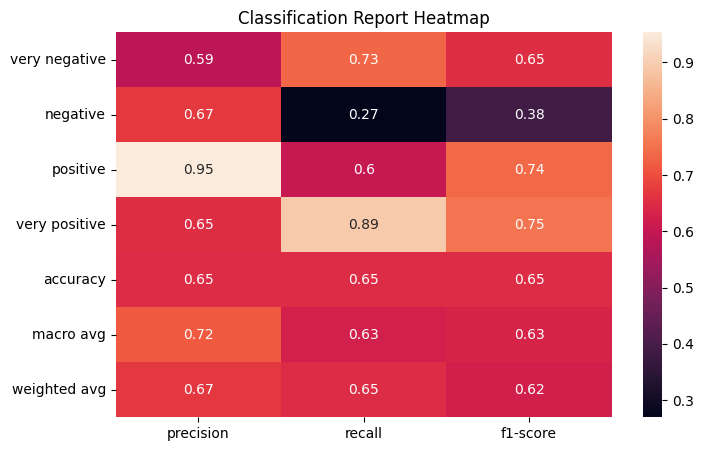

DecisionTreeClassifier(max_depth=6, random_state=1)

In [114]:
create_decision_tree(x_features_original, y_target_original, classes=classes, max_depth=6)

## b- decision tree classifier based on your manipulated data set

### figuring importance of features

create a classifiaction report

In [115]:
x_features = steam_numerical.drop(['rating'], axis=1)
y_target = steam_numerical['rating']

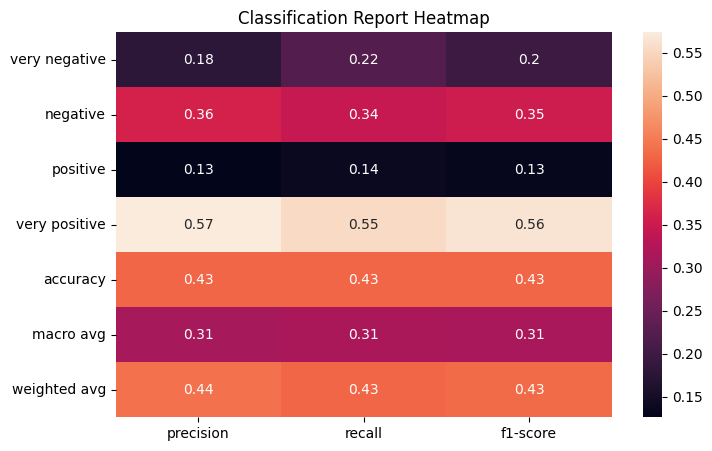

In [116]:
clf = create_decision_tree(x_features, y_target, classes=classes)

Text(-8.180555555555555, 0.5, 'accuracy')

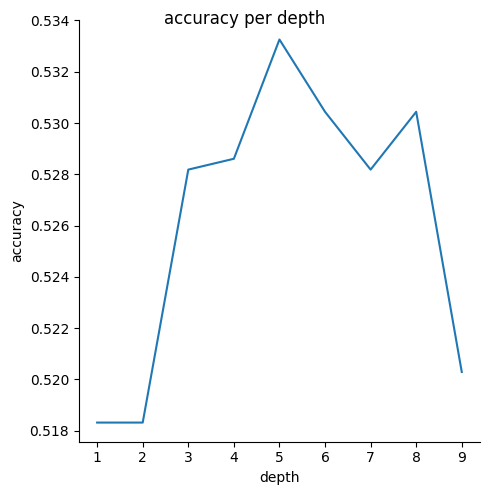

In [117]:
x_features = steam_numerical.drop(['rating'], axis=1)
y_target = steam_numerical['rating']
depths = list(range(1, 10))

x_train, x_test, y_train, y_test = train_test_split(x_features, y_target, test_size=0.3, random_state=1)
accuracy = []

for depth in depths:
  clf = DecisionTreeClassifier(max_depth = depth, random_state=1)
  clf.fit(x_train, y_train)
  score = clf.score(x_test, y_test)
  accuracy.append(score)

%matplotlib inline
ind = np.array(range(len(accuracy))) + np.ones(len(accuracy))
graph = sns.relplot(x=ind, y=accuracy, kind="line")

graph.figure.suptitle('accuracy per depth')
graph.axes[0, 0].set_xlabel('depth')
graph.axes[0, 0].set_ylabel('accuracy')

we get best accuracy with all features in depth of 5, but we lose accuracy on 'very negative' and 'positive'

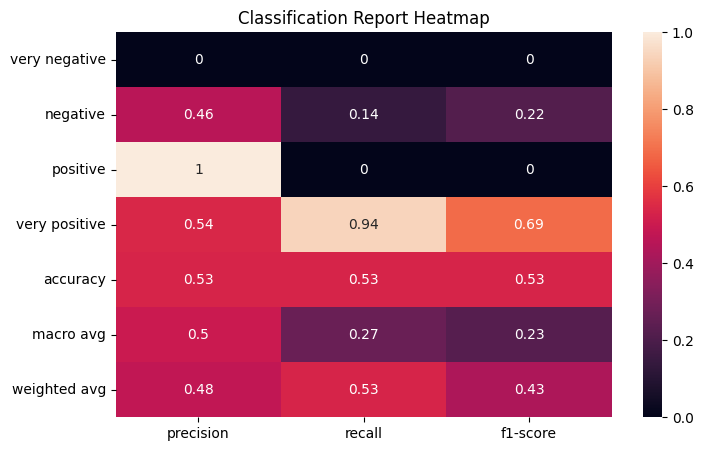

In [118]:
clf = create_decision_tree(x_features, y_target, classes=classes, max_depth = 5)

calculate feature importance

according to the result: price, achievements and release date are the most important features

but I'm to take price and achievements, and leave release date out and see how well the decision tree performs

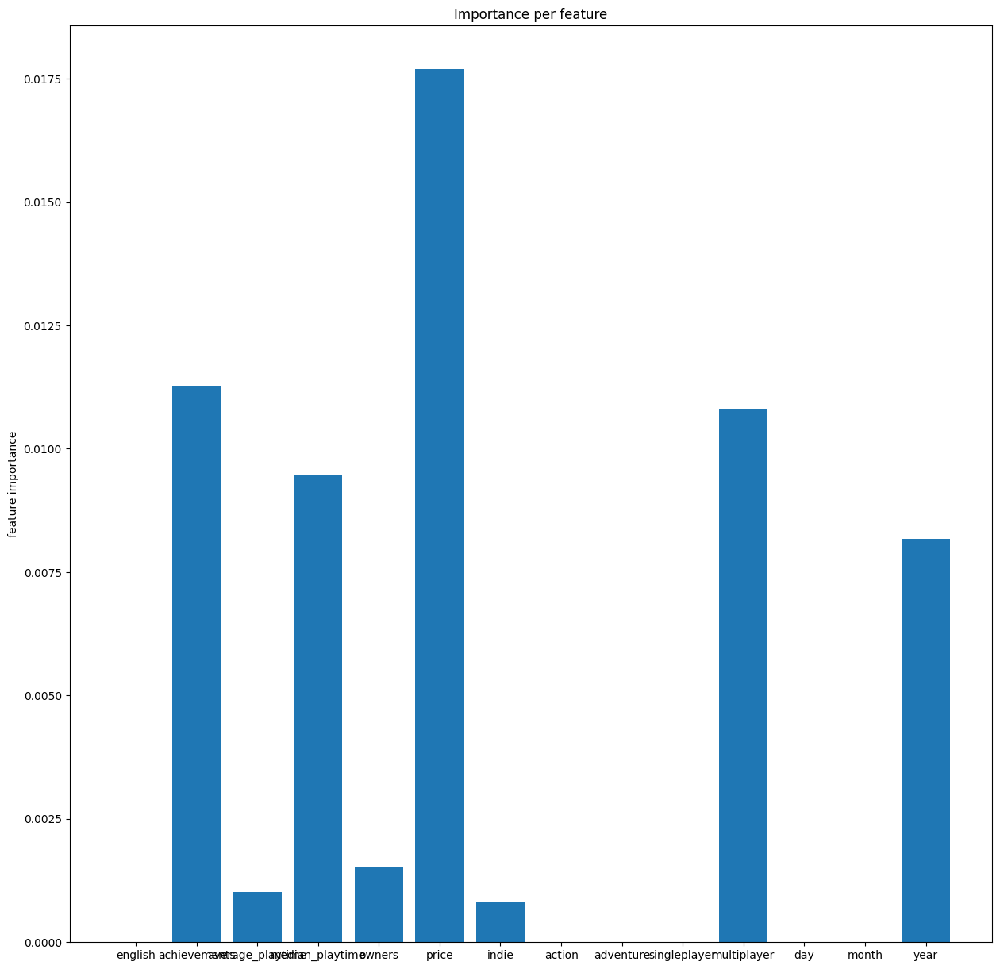

In [119]:
importance = permutation_importance(clf, x_features, y_target, random_state=1, n_repeats=10)

fig = plt.figure(figsize=(15, 15))

plt.bar(range(len(x_features.columns)), importance['importances_mean'])
plt.xticks(ticks=range(len(x_features.columns)), labels=x_features.columns)

plt.ylabel('feature importance') 
plt.title('Importance per feature')
plt.show()

### decision tree

In [120]:
x_features_1 = steam_numerical[['achievements', 'price']]
y_target_1 = steam_numerical['rating']

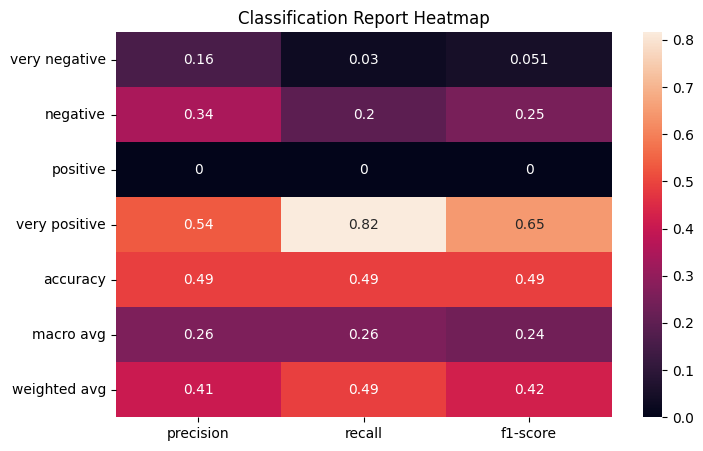

DecisionTreeClassifier(random_state=1)

In [121]:
create_decision_tree(x_features_1, y_target_1, classes=classes)

tree to improve perscision:

first I'll include the release date

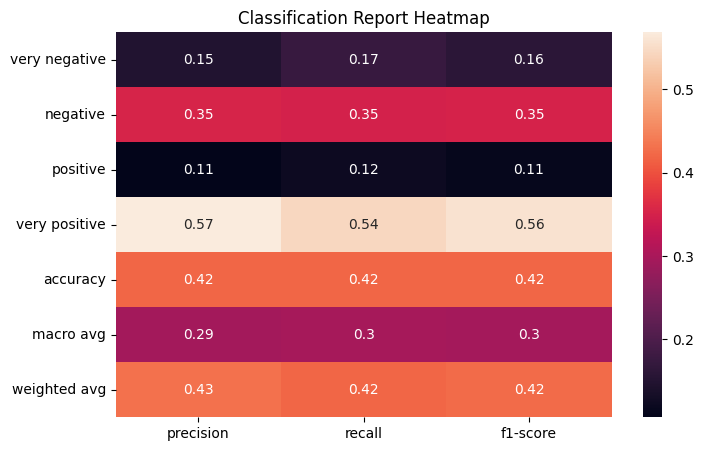

DecisionTreeClassifier(random_state=1)

In [122]:
x_features_2 = steam_numerical[['achievements', 'price', 'day', 'month', 'year']]
y_target_2 = steam_numerical['rating']

create_decision_tree(x_features_2, y_target_2, classes=classes)

Now I'll try it with game genres

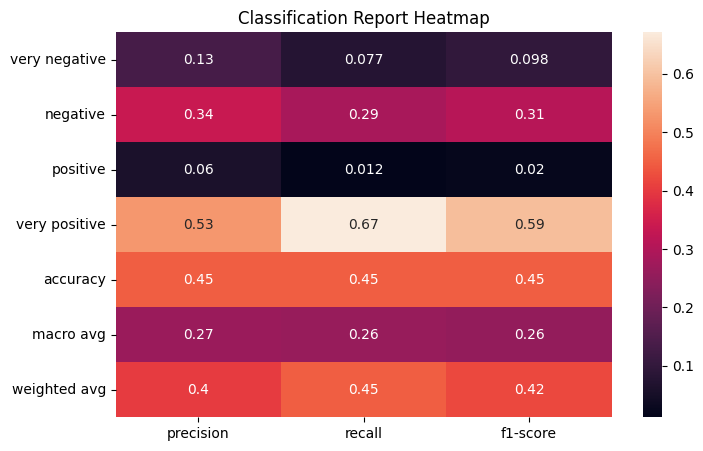

DecisionTreeClassifier(random_state=1)

In [123]:
x_features_3 = steam_numerical[['achievements', 'price', 'indie', 'action', 'adventure']]
y_target_3 = steam_numerical['rating']

create_decision_tree(x_features_3, y_target_3, classes=classes)

this time I'll keep the release date as well as genres

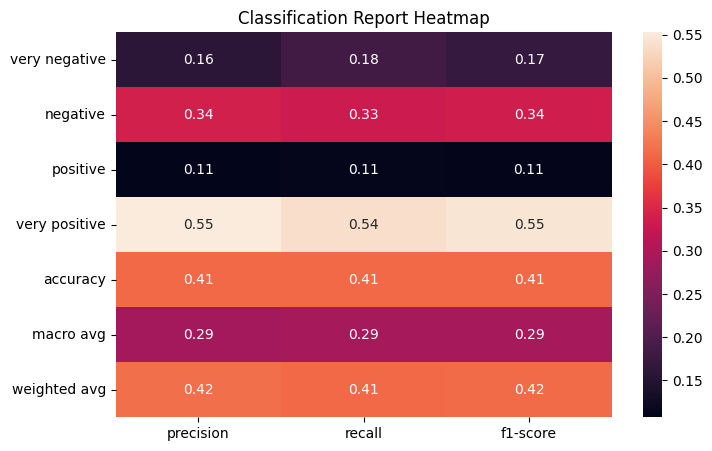

DecisionTreeClassifier(random_state=1)

In [124]:
x_features_4 = steam_numerical[['achievements', 'price', 'indie', 'action', 'adventure', 'day', 'month', 'year']]
y_target_4 = steam_numerical['rating']

create_decision_tree(x_features_4, y_target_4, classes=classes)

this time instead of date i'll include number of owners

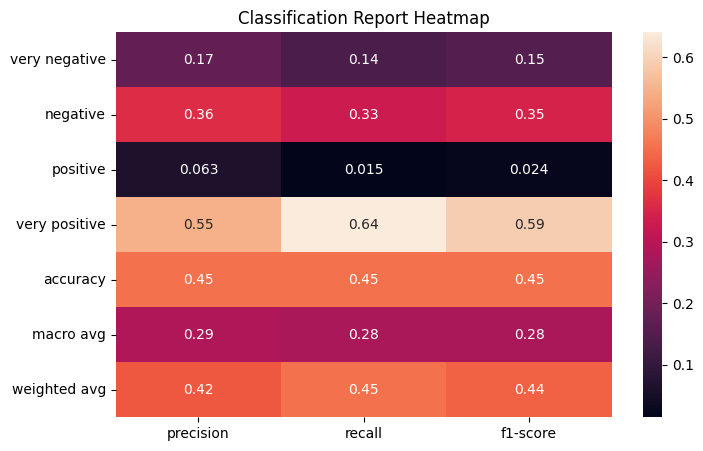

DecisionTreeClassifier(random_state=1)

In [125]:
x_features_4 = steam_numerical[['achievements', 'price', 'indie', 'action', 'adventure', 'owners']]
y_target_4 = steam_numerical['rating']

create_decision_tree(x_features_4, y_target_4, classes=classes)

this time i'll keep only owners and initial two features 

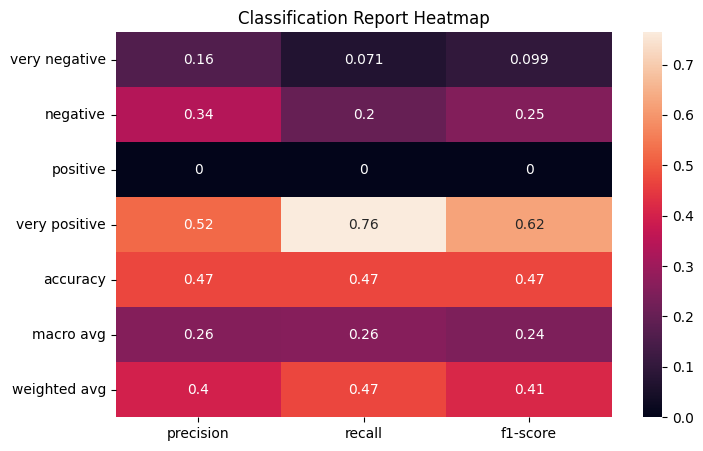

DecisionTreeClassifier(random_state=1)

In [126]:
x_features_5 = steam_numerical[['achievements', 'price', 'owners']]
y_target_5 = steam_numerical['rating']

create_decision_tree(x_features_5, y_target_5, classes=classes)

now I'll keep owners and genres and include average playtime

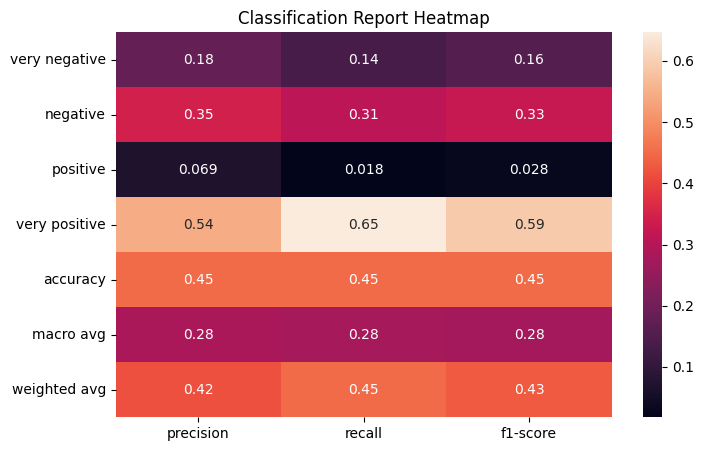

DecisionTreeClassifier(random_state=1)

In [127]:
x_features_6 = steam_numerical[['achievements', 'price', 'average_playtime', 'owners', 'indie', 'action', 'adventure']]
y_target_6 = steam_numerical['rating']

create_decision_tree(x_features_6, y_target_6, classes=classes)

lastly i'll pick some feature I think will do well

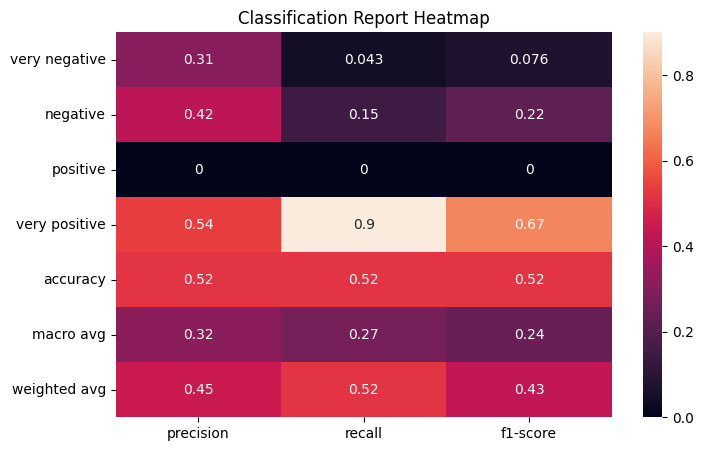

In [128]:
x_features_7 = steam_numerical[['multiplayer', 'owners', 'price']]
y_target_7 = steam_numerical['rating']

clf1 = create_decision_tree(x_features_7, y_target_7, classes=classes)

In [129]:
dot_data = StringIO()
export_graphviz(clf1, out_file=dot_data, filled=True, rounded=True, feature_names=x_features_7.columns, class_names=clf1.classes_)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('decision_tree.png')
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.716313 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.716313 to fit



finding best accuracy according to depth, we can see that depth of 3 is best

Text(-8.180555555555555, 0.5, 'accuracy')

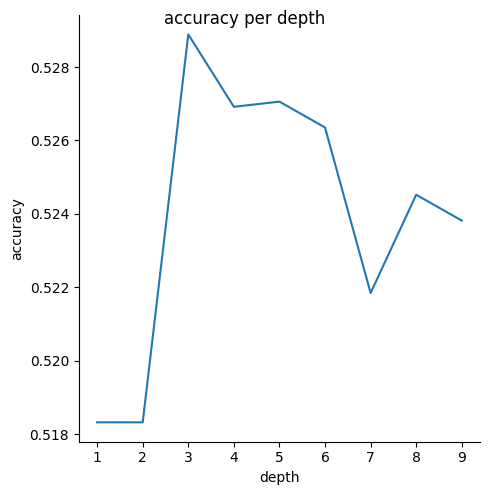

In [130]:
# https://towardsdatascience.com/understanding-decision-trees-for-classification-python-9663d683c952

x_features = steam_numerical[['multiplayer', 'owners', 'price']]
y_target = steam_numerical['rating']
depths = list(range(1, 10))

x_train, x_test, y_train, y_test = train_test_split(x_features, y_target, test_size=0.3, random_state=1)
accuracy = []

for depth in depths:
  clf = DecisionTreeClassifier(max_depth = depth, random_state=1)
  clf.fit(x_train, y_train)
  score = clf.score(x_test, y_test)
  accuracy.append(score)

%matplotlib inline
ind = range(len(accuracy)) + np.ones(len(accuracy))
graph = sns.relplot(x=ind, y=accuracy, kind="line")

graph.fig.suptitle('accuracy per depth')
graph.axes[0, 0].set_xlabel('depth')
graph.axes[0, 0].set_ylabel('accuracy')

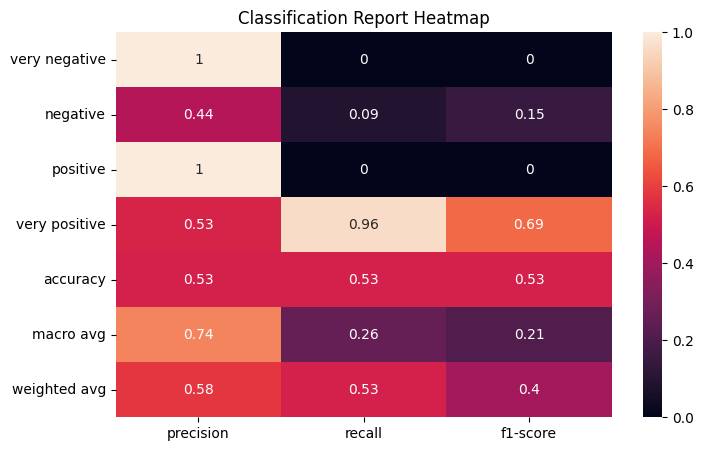

In [131]:
clf = create_decision_tree(x_features, y_target, classes=classes, max_depth=5) 

**Conclusion**

the best result were when I've had multiplayer, owners and price with a depth of 3. but for having enough depth I'll go with second best which is 5

but we lose accuracy on 'very negative' and 'positive'. but this behavior is the same with all features included

To visualize the prediction accuracy:

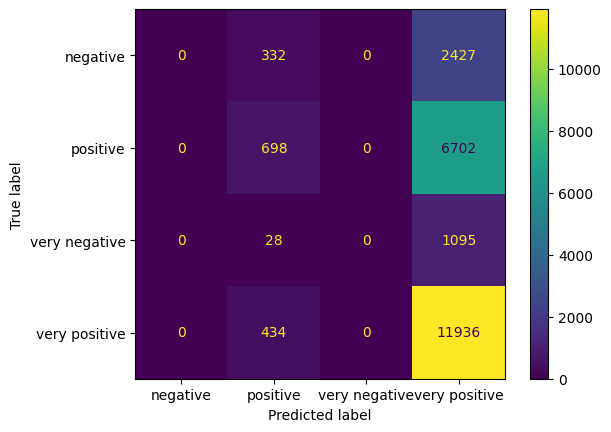

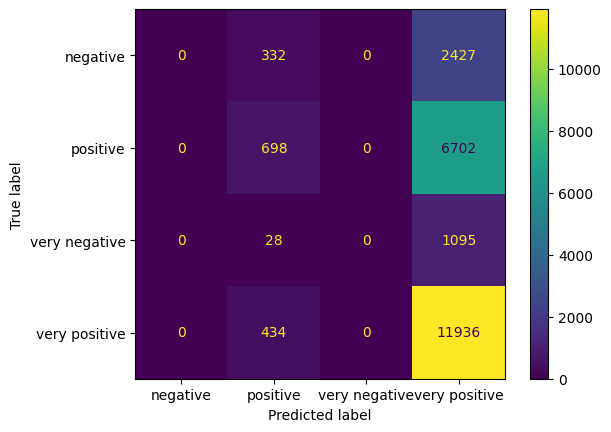

In [132]:
y_pred = clf.predict(x_features)

cm_display = ConfusionMatrixDisplay.from_estimator(clf, x_features, y_target)
cm_display.plot()
plt.show()

Drawing the tree:

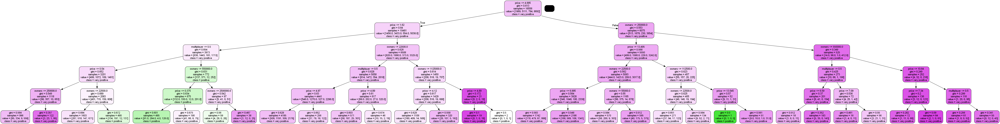

In [133]:
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data, filled=True, rounded=True, feature_names=x_features.columns, class_names=clf.classes_)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('decision_tree_depth_5.png')
Image(graph.create_png())

# Summary



*   In the dataset I analyized, I've tried finding a relation between different features to the rating of the games
*   In the dataset there wasn't that many outliers or bad data
*   One issue was that the 'genres' and 'categories' features had many values in them as a string, and splitting them would add 200+ onehot encoded columns per feature
*   The way I dealt with this is that I've decided to choose only singleplayer and multiplayer for categories. And for genres I've choosen three genres that are more general than others and unique to each other which are indie, action and adventure
*   Analyzing the data I've noticed that games had released more frequently starting from 2014 and peaking at 2018
*   In General there was no direct and clear correlation between a signle feature to the rating of a game
*   I've noticed that certain type of games have more achievements that others. for example singleplayer games have more, or games that are indie.
*   As for the classification performance measure, reducing the number of genres and categories have reduced the percision of guessing the rating but not by much
*   Running the decision tree on the original data (after onehot encoding the genre and categories) have given a slightily better percision
*   Running the decision tree on the modified dataset has given slightly worse percision, yet close.
*   Reducing the number of features used in the decision tree haven't caused a dramatic change in percision
*   Conclusion: for a better decision tree it would be better to use the original dataset (specially that during the analysis there wasn't that much outliers or bad data)



### This section includes dataset preprocessing:
- Extracting 'season' from release_date ✅
- Computing total_reviews ✅
- Creating the 'Rating' classification ✅

## Data Preprocessing & Feature Engineering

In [134]:

import pandas as pd
import numpy as np
from datetime import datetime

df = pd.read_csv('steam.csv')

# Convert release_date to datetime format
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')

def get_season(date):
    if pd.isnull(date):
        return np.nan
    month = date.month
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    else:
        return 'Fall'

df['season'] = df['release_date'].apply(get_season)

# Compute total_reviews
df['total_reviews'] = df['positive_ratings'] + df['negative_ratings']

df['positive_review_percentage'] = (df['positive_ratings'] / df['total_reviews']) * 100

def classify_rating(percentage):
    if percentage >= 85:
        return 'Very Positive'
    elif percentage >= 70:
        return 'Positive'
    elif percentage >= 40:
        return 'Negative'
    else:
        return 'Very Negative'

df['Rating'] = df['positive_review_percentage'].apply(classify_rating)

selected_columns = ['release_date', 'achievements', 'median_playtime', 'price', 
                    'total_reviews', 'average_playtime', 'english', 'categories', 
                    'owners', 'season', 'Rating']
df = df[selected_columns]

df.dropna(inplace=True)

df.to_csv('ready_dataset.csv', index=False)

print("Data processing complete. Processed dataset saved as 'ready_dataset.csv'.")


Data processing complete. Processed dataset saved as 'ready_dataset.csv'.
